In [1]:
# import required libraries to munge data
import pandas as pd
import numpy as np

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt

In [3]:
# import matplotlib to draw plot inside of notebook
%matplotlib inline
from mpl_toolkits.mplot3d.axes3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib import cm

In [4]:
# Start from grid table
acc_table = pd.read_csv("../../log/grid_10_epoches.csv", header=0)
grid_table = acc_table

In [5]:
def select_case(table, kv, selected_dim, output, plot=False):
    subset_table = table
    x_col = selected_dim
    for k in kv:
        subset_table = subset_table[subset_table[k] == kv[k]]
    if plot:
        subset_table.plot(x=x_col, y=[output], figsize=(8, 8), kind="scatter")
        
    return (subset_table)    

In [6]:
from math import log
def log_scale(list, base=2):
    """apply log2 function to all list item"""
    for i in range(len(list)):
        list[i] = log(list[i], base)
    return list

In [7]:
def create_best_error_list(grid_table):
    # munge table to record best accuracy of hyperparameter vector which measured at each epochs
    epoch_table = grid_table[grid_table["Measure Type"] == "epoch"]

    best_list = []
    filter_sizes = set(grid_table['Param1'].values.tolist()) 
    conv1_depths = set(grid_table['Param2'].values.tolist()) 
    conv2_depths = set(grid_table['Param3'].values.tolist()) 
    fc_depths = set(grid_table['Param4'].values.tolist()) 
    
    for filter_size in filter_sizes:
        for conv1_depth in conv1_depths:
            for conv2_depth in conv2_depths:
                for fc_depth in fc_depths:
                    selection = {"Param1": filter_size, "Param2" : conv1_depth, "Param3" : conv2_depth, "Param4" : fc_depth}
                    case = select_case(epoch_table, selection, "Step", "Metric1", False)
                    
                    best_test_error = (100.0 - max(case["Metric1"])) / 100.0 # 0 - 1 scale
                    if best_test_error > 1:
                        print max(case["Metric1"])
                    
                    best_case = {"Filter size" : filter_size, "Conv1 depth": conv1_depth, \
                                 "Conv2 depth" : conv2_depth, "FC neurons" : fc_depth, "Best Test Error" : best_test_error}
                    best_list.append(best_case)
    
    return best_list

In [8]:
def create_best_error_table(best_list, total_only_table):
    merged_list = []
    for best_condition in best_list:
        selection = {"Filter size": best_condition["Filter size"],\
                     "Conv1 depth" : best_condition["Conv1 depth"],\
                     "Conv2 depth" : best_condition["Conv2 depth"],\
                     "FC neurons" : best_condition["FC neurons"]}
        row = select_case(total_only_table, selection, "Elapsed Time", "Test Error")
        items = row.values.tolist()
        
        if len(items) >= 1:            
            item = items[0]
            #print item
            best_condition["Elapsed Time"] = row["Elapsed Time"].values.tolist()[0] 
            if item[5] > best_condition["Best Test Error"]:
                best_condition["Best Test Error"] = row["Test Error"].values.tolist()[0]  # XXX: find the magic number means
        else:
            #print (selection) # print out missing conditions
            best_condition["Elapsed Time"] = "NA"
        merged_list.append(best_condition)
    merged_table = pd.DataFrame(merged_list)
    #merged_table.head(10)
    return merged_table

In [9]:
def create_totalonly_table(grid_table):
    # munge table by selecting total only
    measureType = "total"
    total_only_table = grid_table[grid_table["Measure Type"] == measureType]
    total_only_table["Test Error"] = (100.0 - total_only_table["Metric1"]) / 100.0 # 0 - 1 scale
    total_only_table.rename(columns={"Param1": "Filter size", "Param2": "Conv1 depth", "Param3": "Conv2 depth", "Param4": "FC neurons"}, inplace=True)
    total_only_table = pd.DataFrame(total_only_table[[ "Filter size", "Conv1 depth", "Conv2 depth", "FC neurons", "Elapsed Time", "Test Error"]])
    total_only_table = total_only_table.sort_values(["Filter size", "Conv1 depth", "Conv2 depth", "FC neurons"], \
                                                    ascending=[True, True, True, True])
    total_only_table = total_only_table.reset_index(drop=True)

    #total_only_table.describe()
    return total_only_table

In [10]:
def create_subset_table(grid_table, measureType):
    
    subset_table = grid_table[grid_table["Measure Type"] == measureType]
    subset_table["Test Error"] = (100.0 - subset_table["Metric1"]) / 100.0 # 0 - 1 scale 
    subset_table.rename(columns={"Param1": "Filter size", "Param2": "Conv1 depth", "Param3": "Conv2 depth", "Param4": "FC neurons"}, inplace=True)
    subset_table = pd.DataFrame(subset_table[["Step", "Filter size", "Conv1 depth", "Conv2 depth", "FC neurons", "Elapsed Time", "Test Error"]])
    subset_table = subset_table.sort_values(["Step", "Filter size", "Conv1 depth", "Conv2 depth", "FC neurons"], \
                                                    ascending=[True, True, True, True, True])
    subset_table = subset_table.reset_index(drop=True)

    #subset_table.describe()
    return subset_table

In [11]:
# Extract an one dimension
def get_one_dim(table, kv, selected_dim, output, log_x=True, log_y= True, plot=False):
    subset_table = table
    x_col = selected_dim
    for k in kv:
        subset_table = subset_table[subset_table[k] == kv[k]]
    
    if log_x: # log 2 transformation
        logscale_x = "log2(" + selected_dim + ")"
        subset_table[logscale_x] = log_scale(subset_table[selected_dim].values.tolist())
        x_col = logscale_x

    if log_y:  # log 10 transformation
        logscale_y = "log10(" + output + ")"
        subset_table[logscale_y] = log_scale(subset_table[output].values.tolist(), 10)
        output = logscale_y
        
    if plot:
        subset_table.plot(x=x_col, y=[output], figsize=(8, 8))
        
    return (subset_table)

In [12]:
best_list = create_best_error_list(grid_table)
total_only_table = create_subset_table(grid_table, "total")
merged_table = create_best_error_table(best_list, total_only_table)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/local/lib/python2.7/dist-packages/pandas/core/frame.py:2754: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  **kwargs)


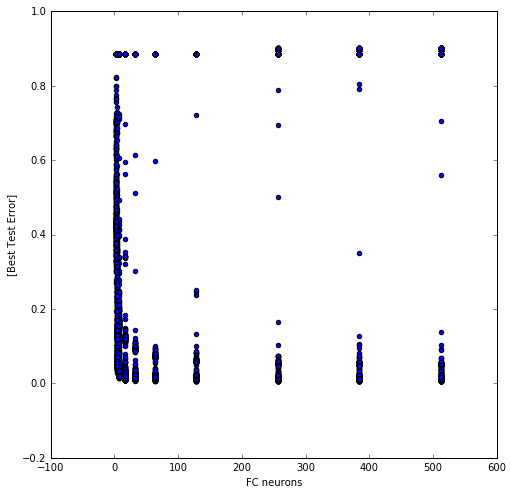

In [13]:
output = "Best Test Error"
selected_dim = "FC neurons"
condition = {}
one_dim_table = select_case(merged_table, condition, selected_dim, output, True)
#one_dim_table.describe()

In [14]:
# TODO: draw box plot diagram here
def draw_box_plots(table, selected_dim, output):
    fig = plt.figure(num=None, figsize=(25, 15), dpi=200, facecolor='w', edgecolor='k')
    
    ax = fig.add_subplot(111)
    x_values = sorted(set(table[selected_dim]))
    box_list = []
    selection = {}    
    for x_value in x_values:
        selection[selected_dim] = x_value
        x = select_case(table, selection, selected_dim, output)
        x = x[output].values.tolist()
        box_list.append(x)

    ax.boxplot(box_list)
    ax.set_xticklabels(x_values, fontsize=20)
    plt.ylabel(output, fontsize=20)
    plt.xlabel(selected_dim, fontsize=20)
    plt.show()

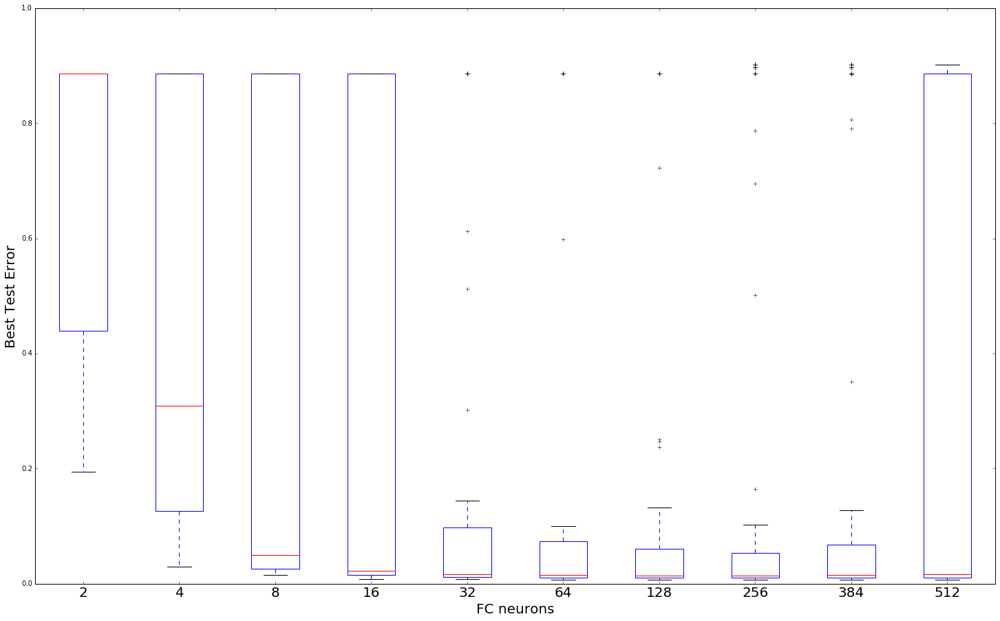

In [15]:
draw_box_plots(one_dim_table, selected_dim, output)

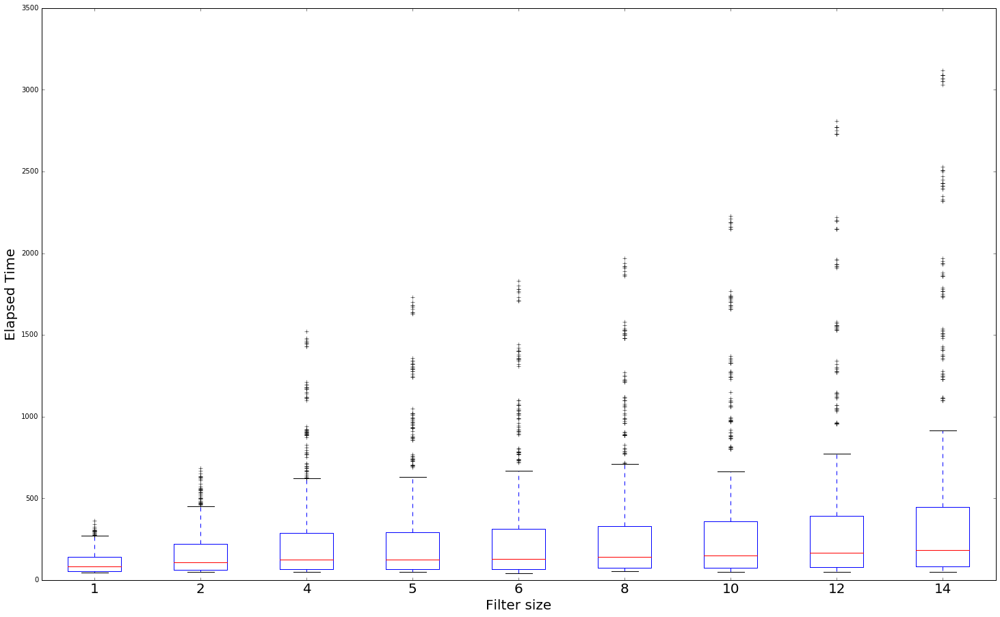

In [16]:
output = "Elapsed Time"
selected_dim = "Filter size"
draw_box_plots(one_dim_table, selected_dim, output)

In [17]:
import matplotlib
# set global font size
font = {'size'   : 20}
matplotlib.rc('font', **font)

def draw_summary_plot(table, selected_dim, title, output = "Best Test Error"):
    
    fig = plt.figure(num=None, figsize=(25, 25), dpi=150, facecolor='w', edgecolor='k')
    fig.suptitle(title, fontsize=40)
    
    x_values = sorted(set(table[selected_dim]))
    error_box_list = []
    best_error_list = [100]
    time_box_list = []
    selection = {}
    best_time_list = [0]
    for x_value in x_values:
        selection[selected_dim] = x_value
        #print selection
        x = select_case(table, selection, selected_dim, output)
        #print len(x[output])
        
        best_error_value = min(x[output])
        best_error_list.append(best_error_value)
        #print x[output]
        # find the appropriate elapsed time
        time_box_values = x["Elapsed Time"].values.tolist()
        time_box_list.append(time_box_values)

        best_time = x[x[output] == best_error_value]["Elapsed Time"]
        best_time = best_time.values[0]
        best_time_list.append(best_time)
        
        error_box_values = x[output].values.tolist()
        logscale_box = log_scale(error_box_values, 10)        
        error_box_list.append(logscale_box)
    
    #print(len(time_box_list))
    #print(len(box_list))
    subplot = fig.add_subplot(211)
    subplot.boxplot(error_box_list) # test error box plot

    subplot2 = subplot.twinx()
    subplot.set_ylim([log(0.005, 10), log(1, 10)]) # 0 - 1 scale
    subplot.set_yticklabels([])
    #print(x_values)
    #print(best_list)
    subplot2.semilogy(best_error_list, color="black", linestyle='--', marker='o', label="Best Test Error")
    subplot2.grid(True)
    subplot2.set_ylim([0.005, 1]) # 0 - 1 scale
    subplot.set_xticklabels(x_values)
    subplot.set_xlim([0, len(x_values) + 1])
    plt.ylabel(output)
    
    plt.legend(loc="best")
    
    subplot3 = fig.add_subplot(212)
    subplot3.plot(best_time_list, color="black", linestyle='--', marker='o', label="Training Time of Best Test Error")
    
    #subplot4 = subplot3.twinx()
    subplot3.boxplot(time_box_list)
    subplot3.set_xlim([0, len(x_values) + 1])
    
    subplot3.set_xticklabels([])
    
    #print(x_values)
    
    subplot.xaxis.grid()
    #subplot.yaxis.grid()
    subplot3.xaxis.grid()
    subplot3.yaxis.grid()
    
    plt.ylabel("Elapsed Time")
    plt.xlabel(selected_dim)
    plt.legend(loc="best")    
    file_name = title + ".png"
    file_name = file_name.replace(" ", "_")
    fig.savefig(file_name, format='png', dpi=200, show=False)
    plt.show()

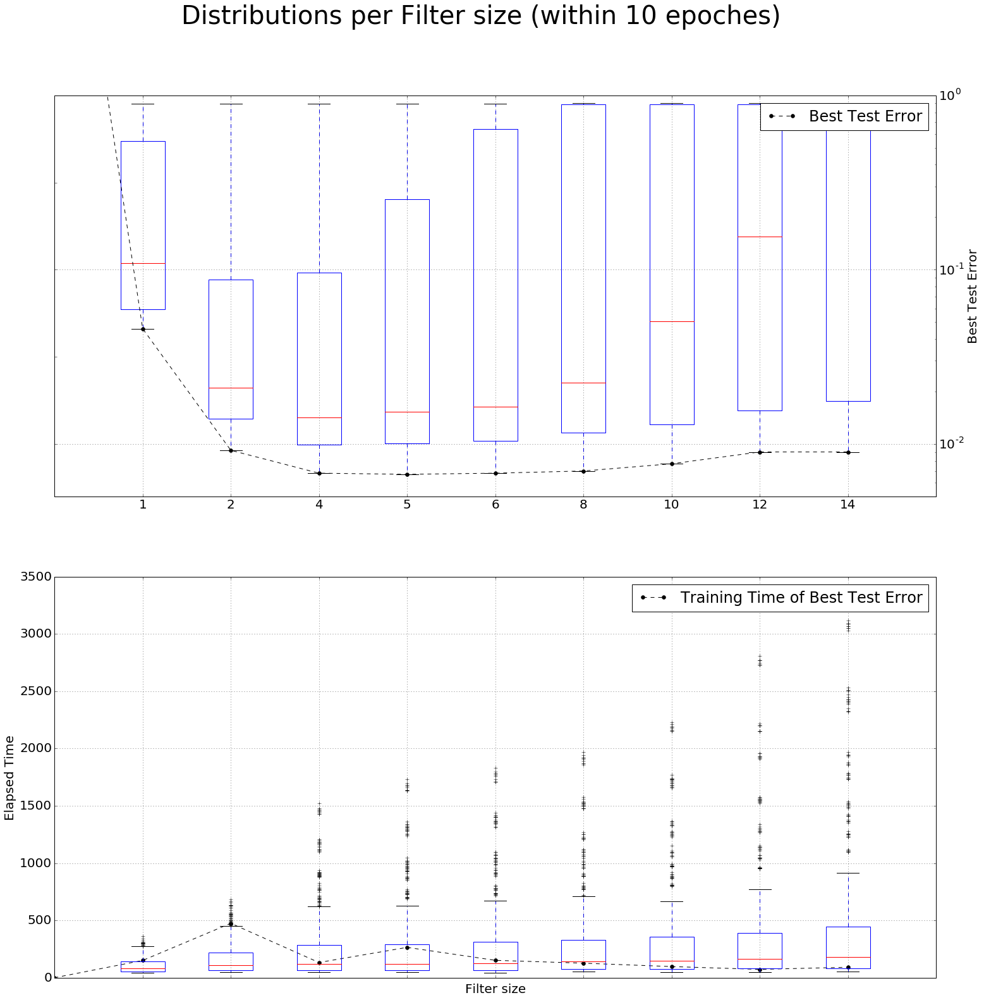

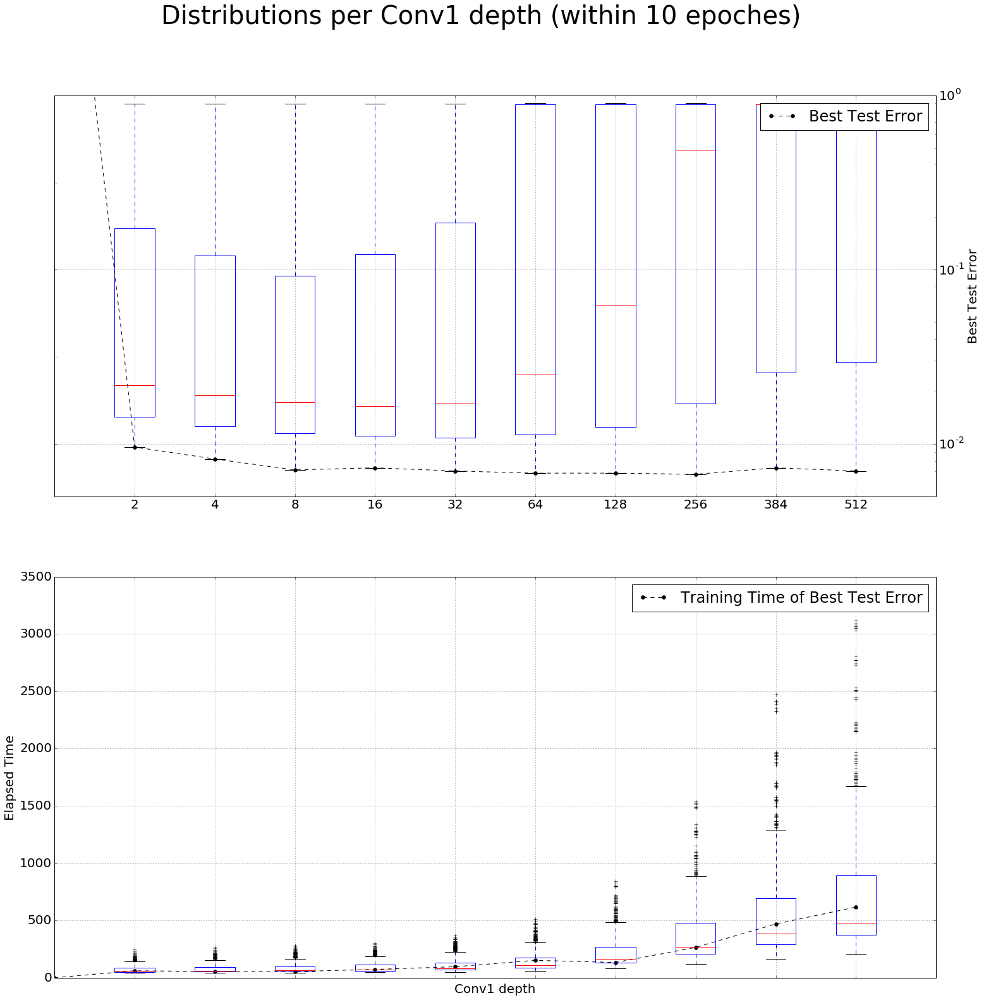

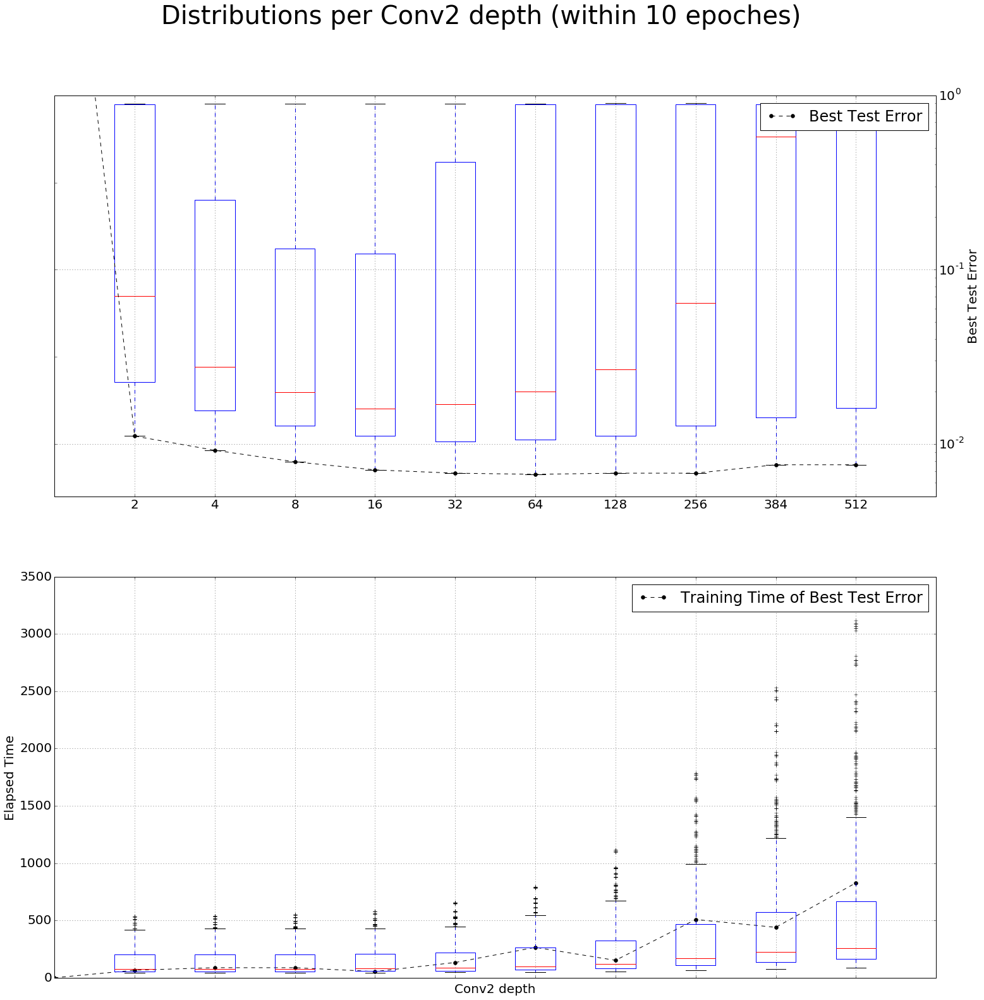

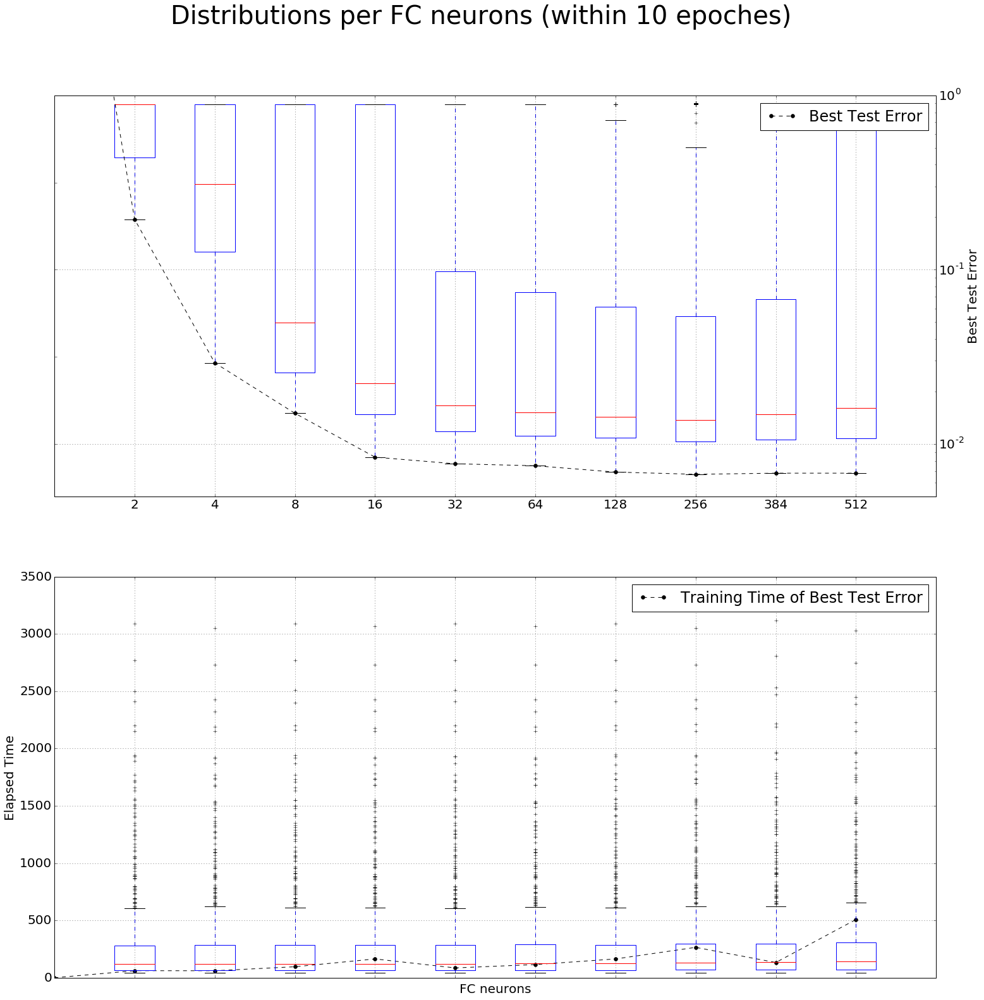

In [18]:
selected_dims = ["Filter size", "Conv1 depth", "Conv2 depth", "FC neurons"]
for selected_dim in selected_dims:
    draw_summary_plot(merged_table, selected_dim, "Distributions per " + selected_dim + " (within 10 epoches)")

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


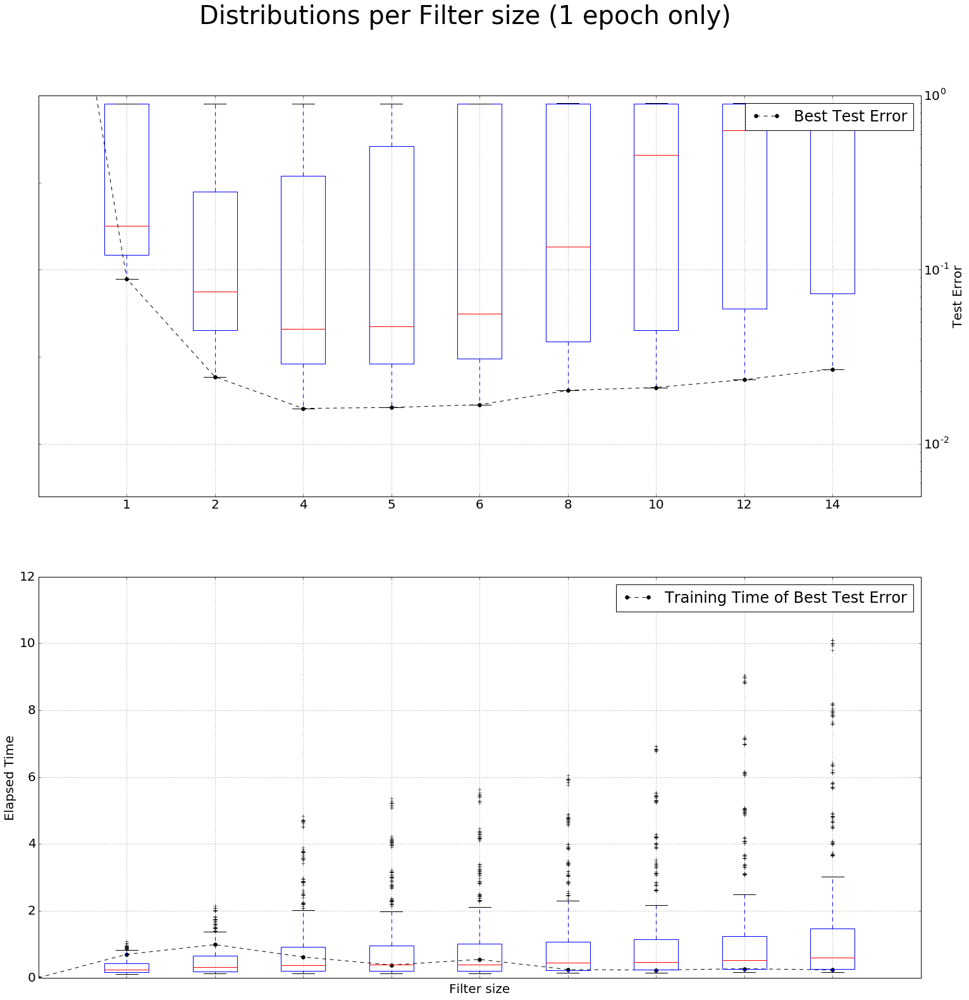

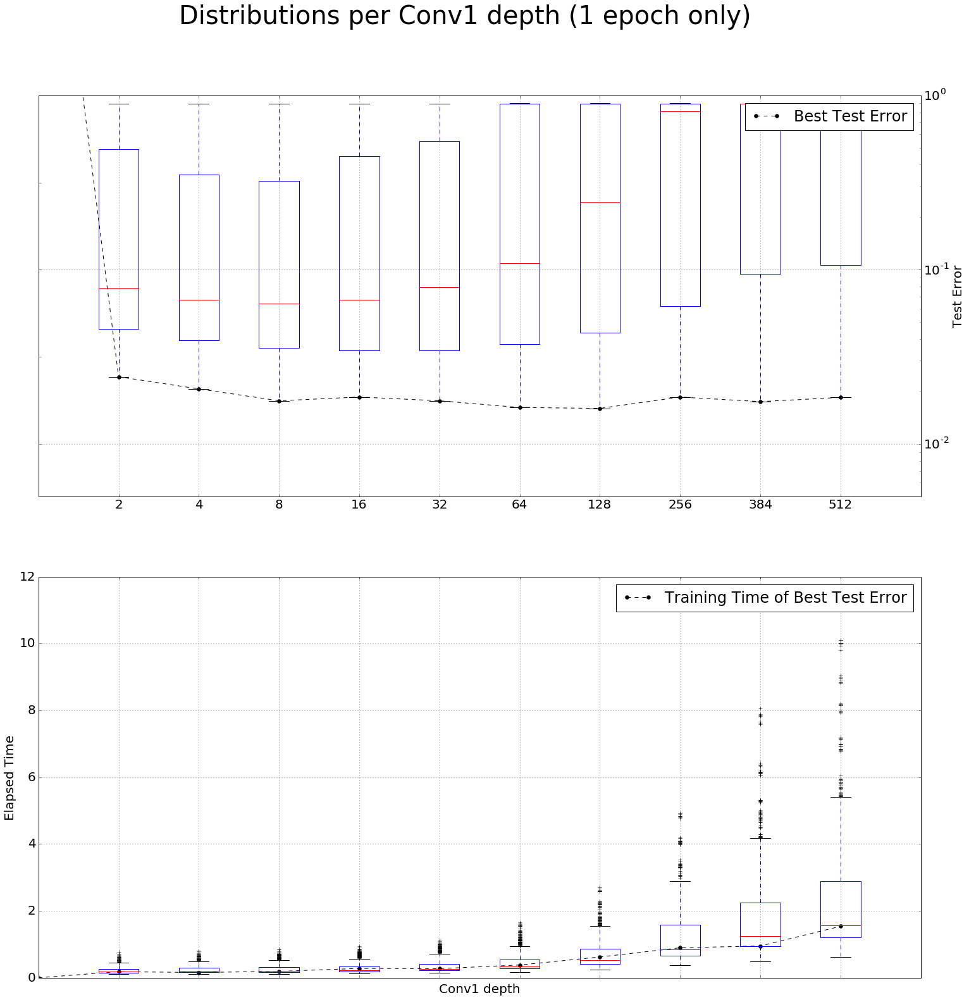

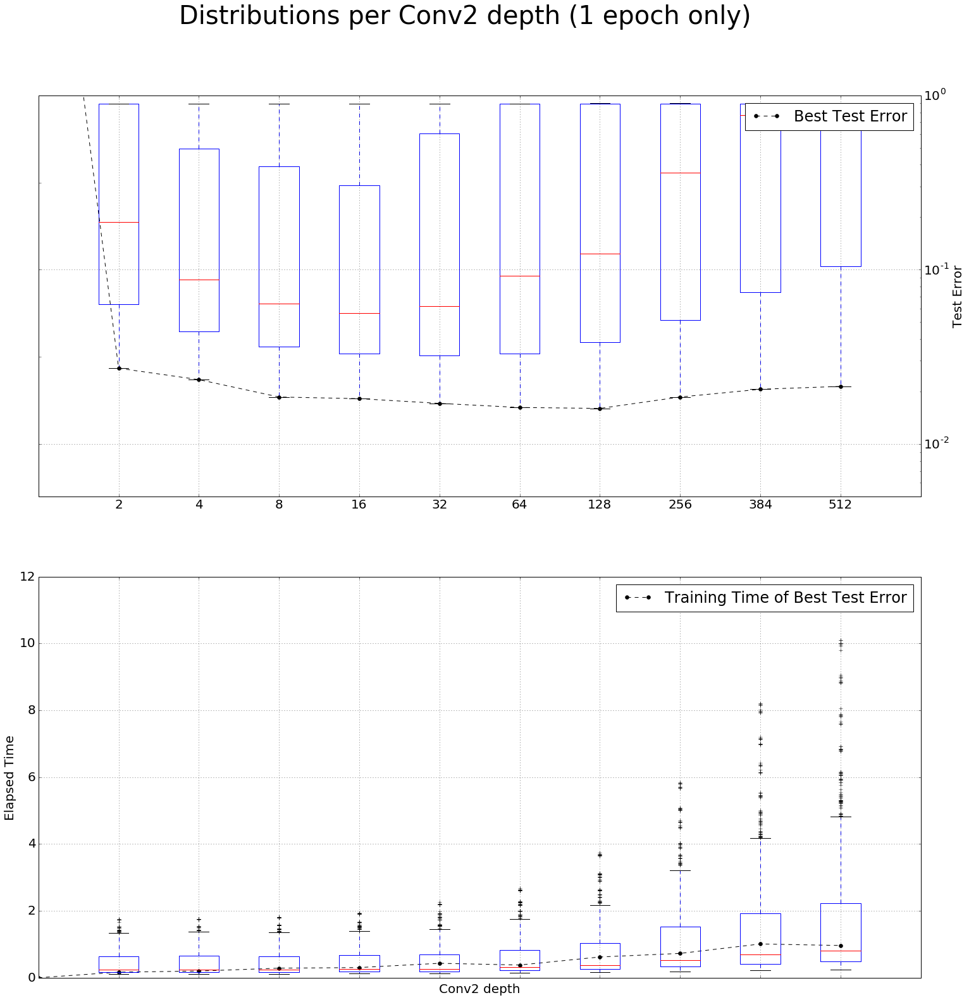

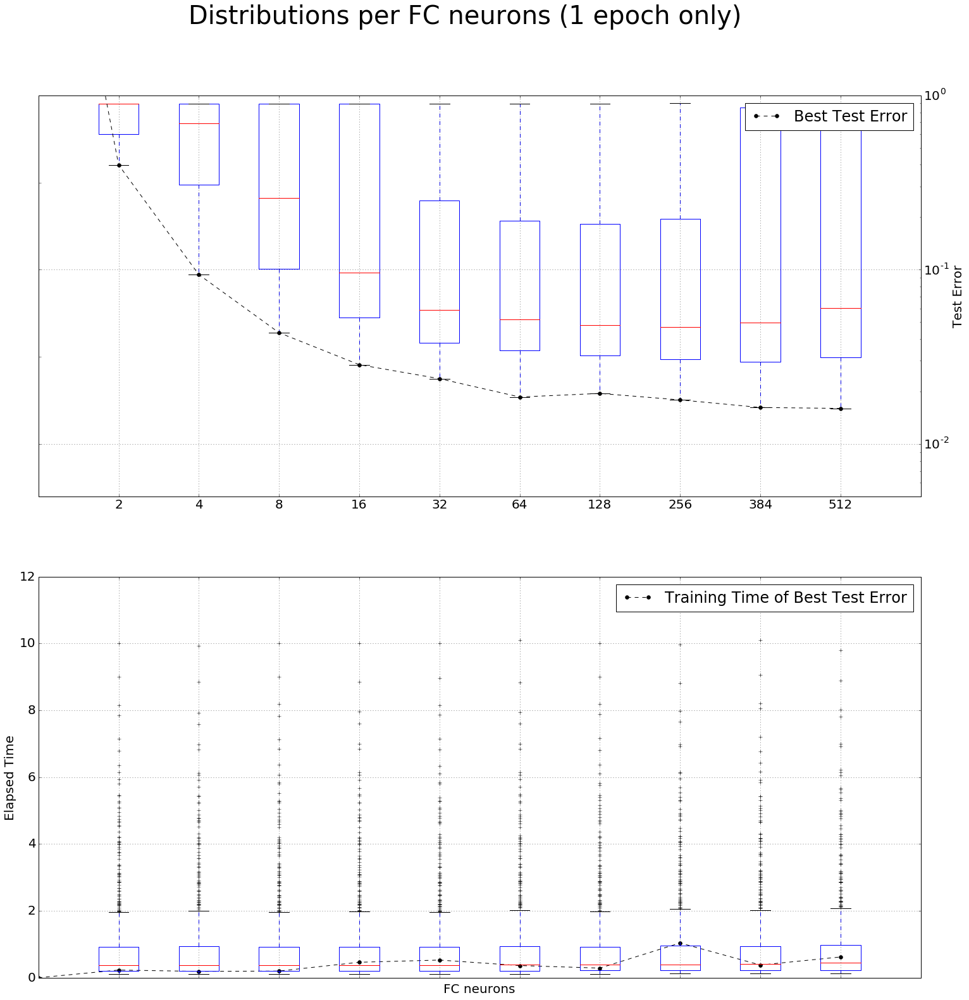

In [19]:

epoch_table = create_subset_table(grid_table, "epoch")
epoch_1_table = epoch_table[epoch_table["Step"] == "1_epoch"]

for selected_dim in selected_dims:
    draw_summary_plot(epoch_1_table, selected_dim, "Distributions per " + selected_dim + " (1 epoch only)", output = "Test Error")

In [20]:
# find the distribution of best test error in each epochs
best_error_list = []

filter_sizes = [1, 2, 4, 5, 6, 8, 10, 12, 14]
conv1_depths = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
conv2_depths = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
fc_depths = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]

for filter_size in filter_sizes:
    for conv1_depth in conv1_depths:
        for conv2_depth in conv2_depths:
            for fc_depth in fc_depths:
                selection = {"Filter size": filter_size, "Conv1 depth" : conv1_depth, "Conv2 depth" : conv2_depth, "FC neurons" : fc_depth}
                case = select_case(epoch_table, selection, "Step", "Metric1", False)
                epoch_best = case[case["Test Error"] == min(case["Test Error"])]["Step"]
                epoch_best = epoch_best.values.tolist()[0]               
                
                epoch_num = int(epoch_best.replace('_epoch', ''))
                best_error_list.append(epoch_num)


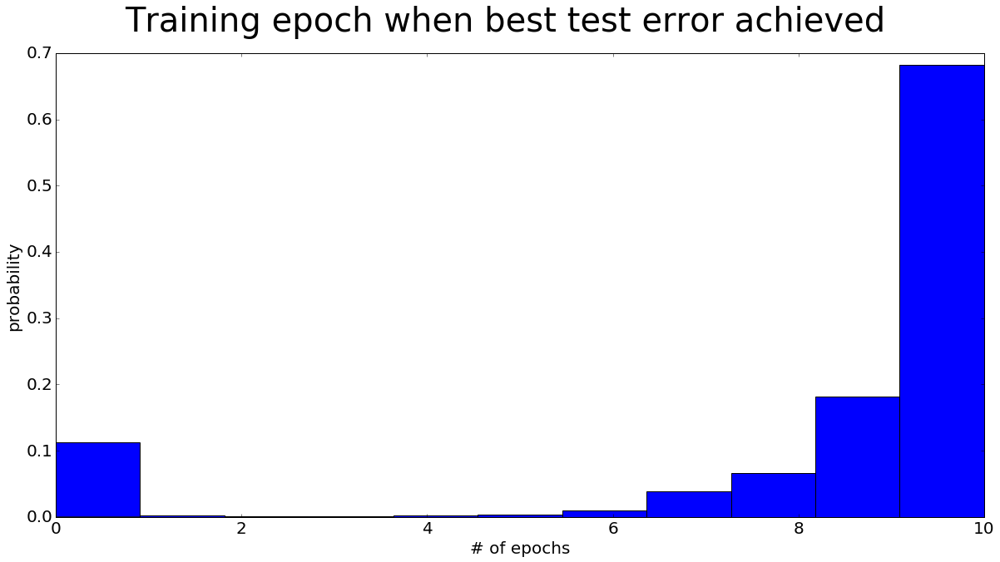

In [21]:
fig = plt.figure(num=None, figsize=(20, 10), dpi=100, facecolor='w', edgecolor='k')
fig.suptitle("Training epoch when best test error achieved", fontsize=40)
subplot = fig.add_subplot(1, 1, 1)

subplot.hist(best_error_list, 11, normed=True)
plt.xlabel("# of epochs")
plt.ylabel("probability")
fig.savefig("epochs_for_best.png", format='png', dpi=200, show=False)
plt.show()

In [22]:
epoch20_all_table = pd.read_csv("../../log/grid_20_epoches.csv", header=0)
epoch20_table = create_subset_table(epoch20_all_table, "epoch")
epoch20_table.head(10)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


,Step,Filter size,Conv1 depth,Conv2 depth,FC neurons,Elapsed Time,Test Error
0,0_epoch,4,16,16,128,0.938,0.9109
1,0_epoch,4,16,16,256,0.848,0.9142
2,0_epoch,4,16,16,384,1.010,0.9402
3,0_epoch,4,16,16,512,0.880,0.8748
4,0_epoch,4,16,16,1024,0.989,0.8656
5,0_epoch,4,16,32,128,1.010,0.9039
6,0_epoch,4,16,32,256,0.895,0.8764
7,0_epoch,4,16,32,384,0.865,0.9178
8,0_epoch,4,16,32,512,0.904,0.9323
9,0_epoch,4,16,32,1024,0.874,0.9133


In [23]:
# find the distribution of best test error in each epochs
best_error_list = []

filter_sizes = [4, 5, 6, 8]
conv1_depths = [16, 32, 64, 128, 256]
conv2_depths = [16, 32, 64, 128, 256]
fc_depths = [128, 256, 384, 512, 1024]

for filter_size in filter_sizes:
    for conv1_depth in conv1_depths:
        for conv2_depth in conv2_depths:
            for fc_depth in fc_depths:
                selection = {"Filter size": filter_size, "Conv1 depth" : conv1_depth, "Conv2 depth" : conv2_depth, "FC neurons" : fc_depth}
                case = select_case(epoch20_table, selection, "Step", "Metric1", False)
                epoch_best = case[case["Test Error"] == min(case["Test Error"])]["Step"]
                epoch_best = epoch_best.values.tolist()[0]               
                
                epoch_num = int(epoch_best.replace('_epoch', ''))
                best_error_list.append(epoch_num)

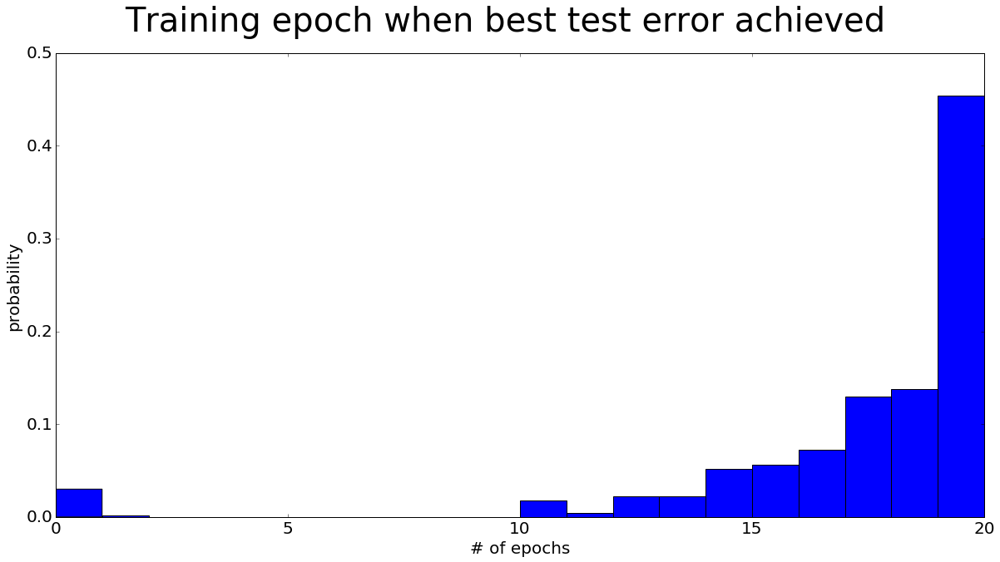

In [24]:
fig = plt.figure(num=None, figsize=(20, 10), dpi=100, facecolor='w', edgecolor='k')
fig.suptitle("Training epoch when best test error achieved", fontsize=40)
subplot = fig.add_subplot(1, 1, 1)

subplot.hist(best_error_list, 20, normed=True)
plt.xlabel("# of epochs")
plt.ylabel("probability")
fig.savefig("20_epochs_for_best.png", format='png', dpi=200, show=False)
plt.show()

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


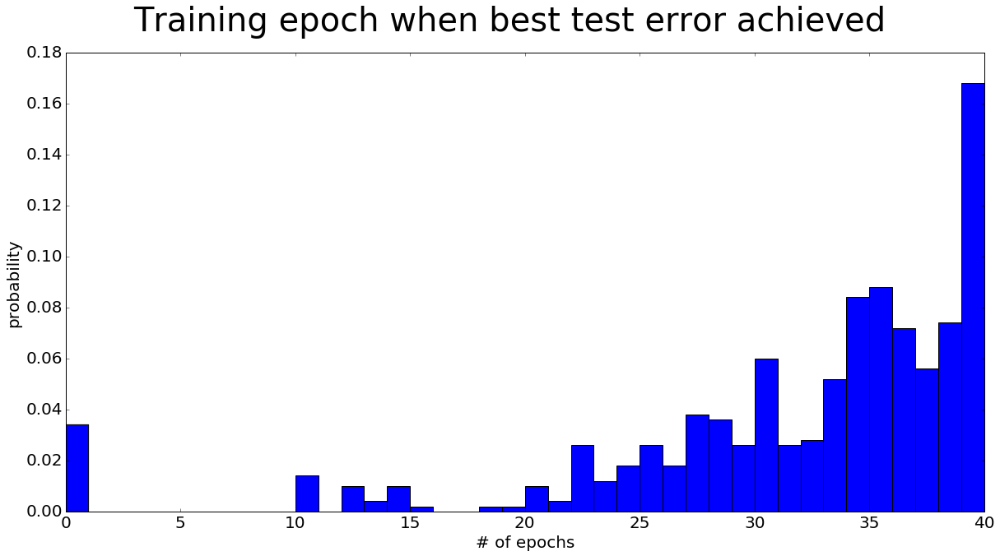

In [25]:

epoch40_all_table = pd.read_csv("../../log/grid_40_epoches.csv", header=0)
epoch40_table = create_subset_table(epoch40_all_table, "epoch")
best_error_list = []

filter_sizes = [4, 5, 6, 8]
conv1_depths = [16, 32, 64, 128, 256]
conv2_depths = [16, 32, 64, 128, 256]
fc_depths = [128, 256, 384, 512, 1024]

for filter_size in filter_sizes:
    for conv1_depth in conv1_depths:
        for conv2_depth in conv2_depths:
            for fc_depth in fc_depths:
                selection = {"Filter size": filter_size, "Conv1 depth" : conv1_depth, "Conv2 depth" : conv2_depth, "FC neurons" : fc_depth}
                case = select_case(epoch40_table, selection, "Step", "Metric1", False)
                epoch_best = case[case["Test Error"] == min(case["Test Error"])]["Step"]
                epoch_best = epoch_best.values.tolist()[0]               
                
                epoch_num = int(epoch_best.replace('_epoch', ''))
                best_error_list.append(epoch_num)

                
fig = plt.figure(num=None, figsize=(20, 10), dpi=100, facecolor='w', edgecolor='k')
fig.suptitle("Training epoch when best test error achieved", fontsize=40)
subplot = fig.add_subplot(1, 1, 1)

subplot.hist(best_error_list, 40, normed=True)
plt.xlabel("# of epochs")
plt.ylabel("probability")
fig.savefig("40_epochs_for_best.png", format='png', dpi=200, show=False)
plt.show()

In [26]:
epoch40_all_table.describe()

/usr/local/lib/python2.7/dist-packages/numpy/lib/function_base.py:3834: RuntimeWarning: Invalid value encountered in percentile
  RuntimeWarning)


,Msec,Elapsed Time,Metric1,Metric2,Metric3,Param1,Param2,Param3,Param4
count,193000.000000,193000.000000,193000.000000,172000.000000,172000.000000,193000.000000,193000.000000,193000.000000,193000.000000
mean,498.116140,2.581340,93.026527,93.172816,93.267884,5.750000,99.200000,99.200000,460.800000
std,288.768014,41.439748,22.260345,21.956722,22.194561,1.479024,87.284589,87.284589,309.326778
min,0.000000,0.160000,4.200000,3.960000,0.000000,4.000000,16.000000,16.000000,128.000000
25%,247.000000,0.436000,99.030000,NaN,NaN,4.750000,32.000000,32.000000,256.000000
50%,497.000000,0.654000,99.230000,NaN,NaN,5.500000,64.000000,64.000000,384.000000
75%,748.000000,1.050000,99.320000,NaN,NaN,6.500000,128.000000,128.000000,512.000000
max,999.000000,2490.000000,99.560000,99.500000,100.000000,8.000000,256.000000,256.000000,1024.000000


In [27]:
best_error_list = create_best_error_list(epoch20_all_table)
total_only_table2 = create_subset_table(epoch20_all_table, "total")
merged_table = create_best_error_table(best_error_list, total_only_table2)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


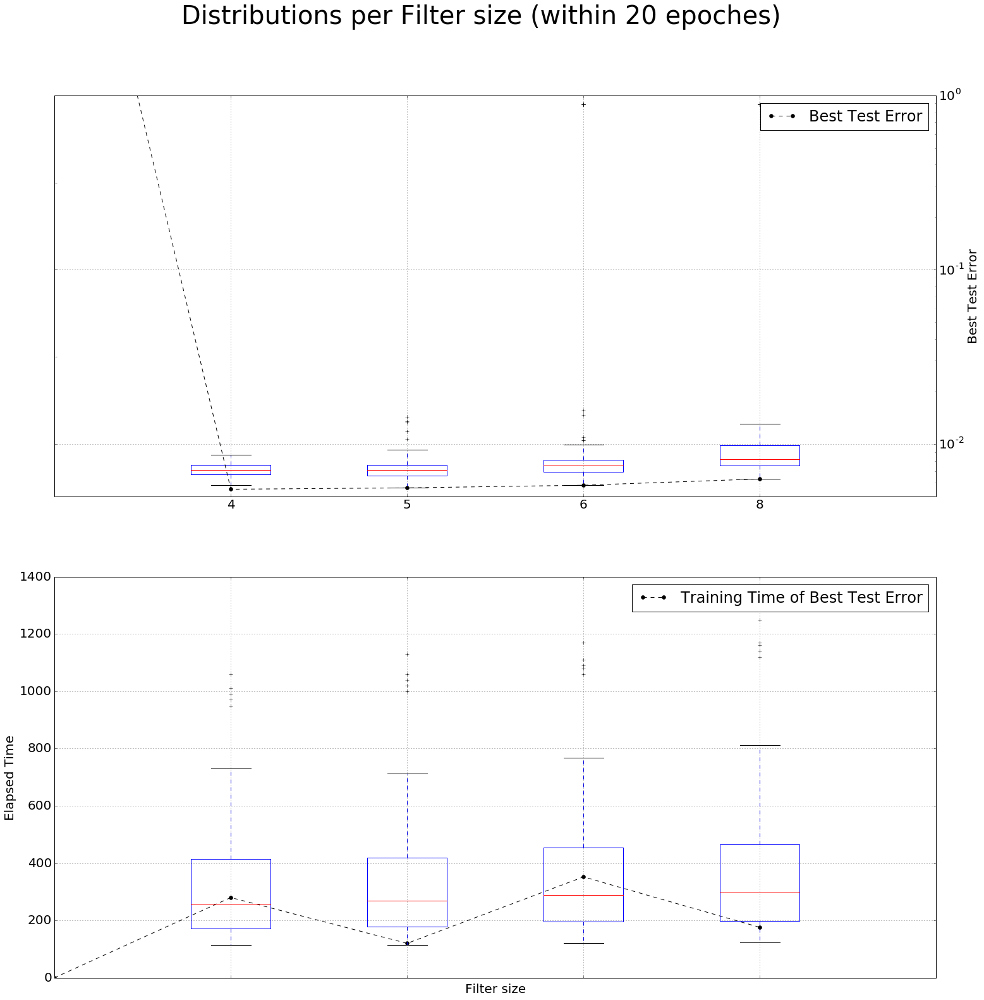

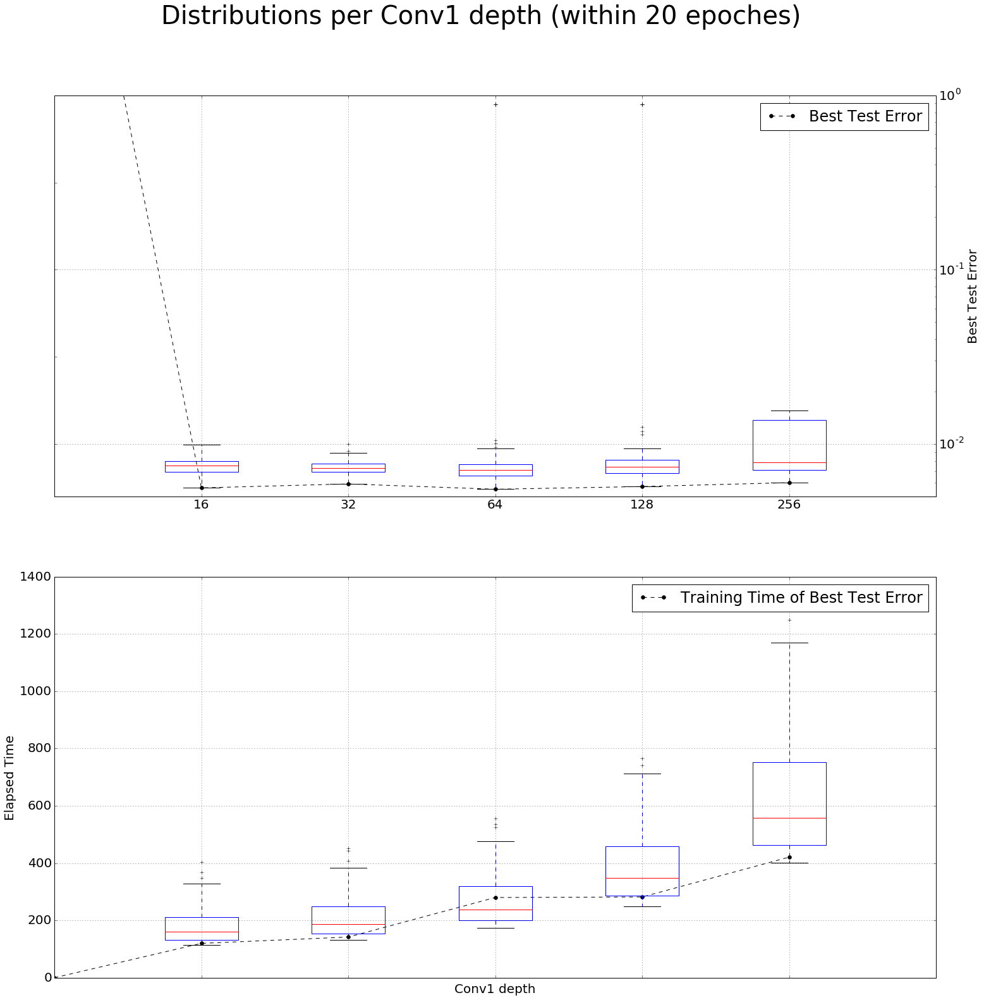

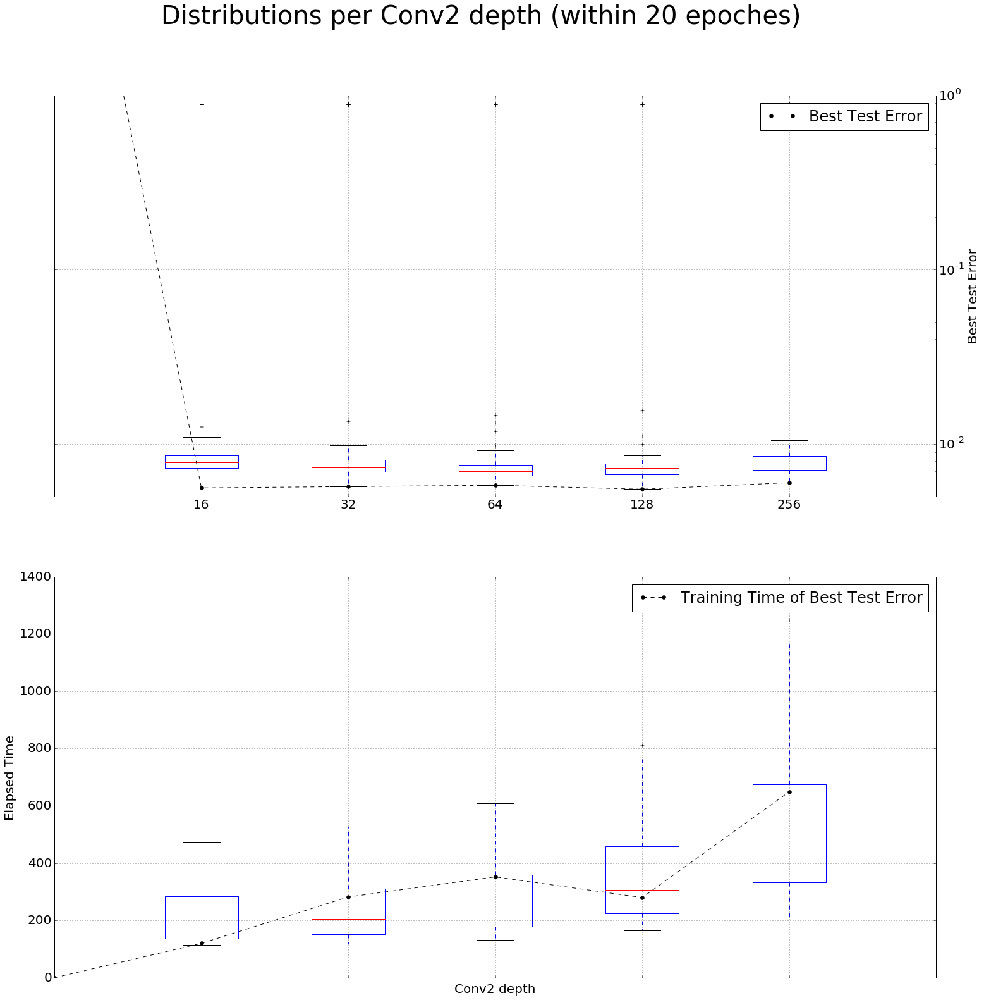

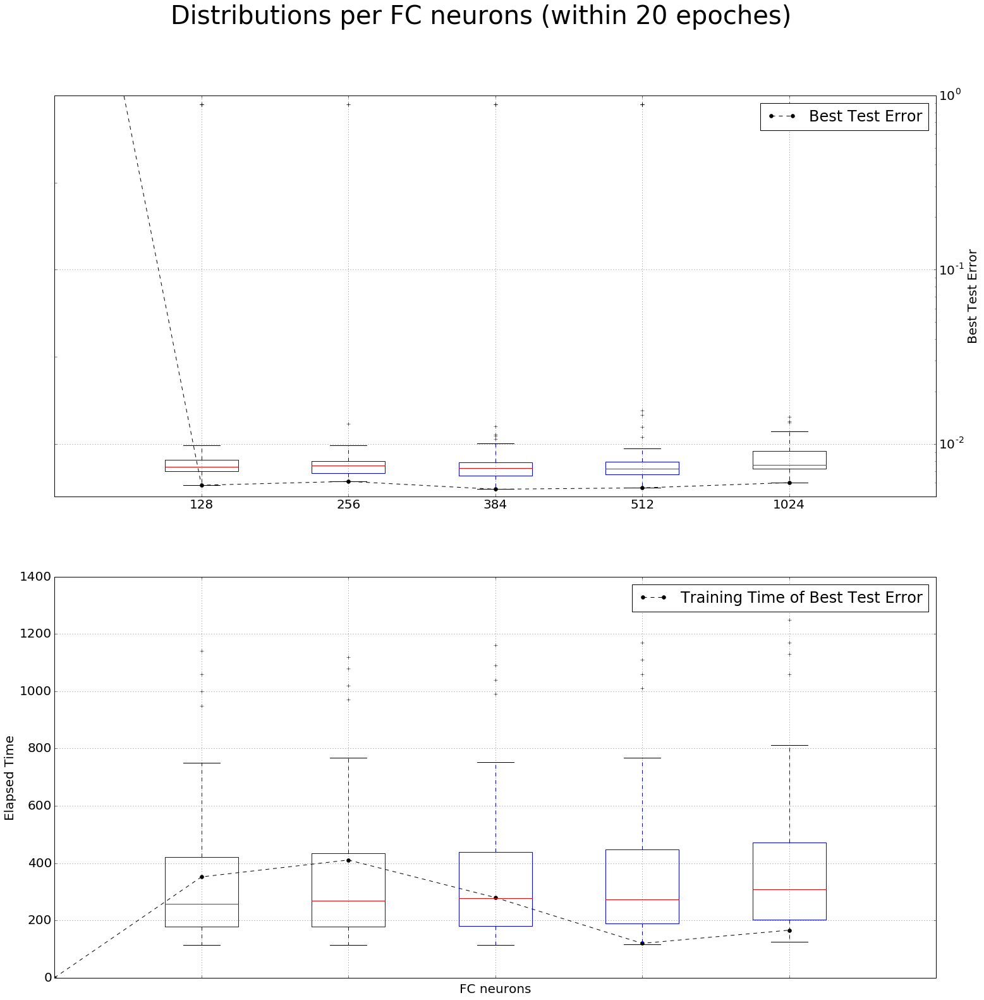

In [28]:
selected_dims = ["Filter size", "Conv1 depth", "Conv2 depth", "FC neurons"]
for selected_dim in selected_dims:
    draw_summary_plot(merged_table, selected_dim, "Distributions per " + selected_dim + " (within 20 epoches)")

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


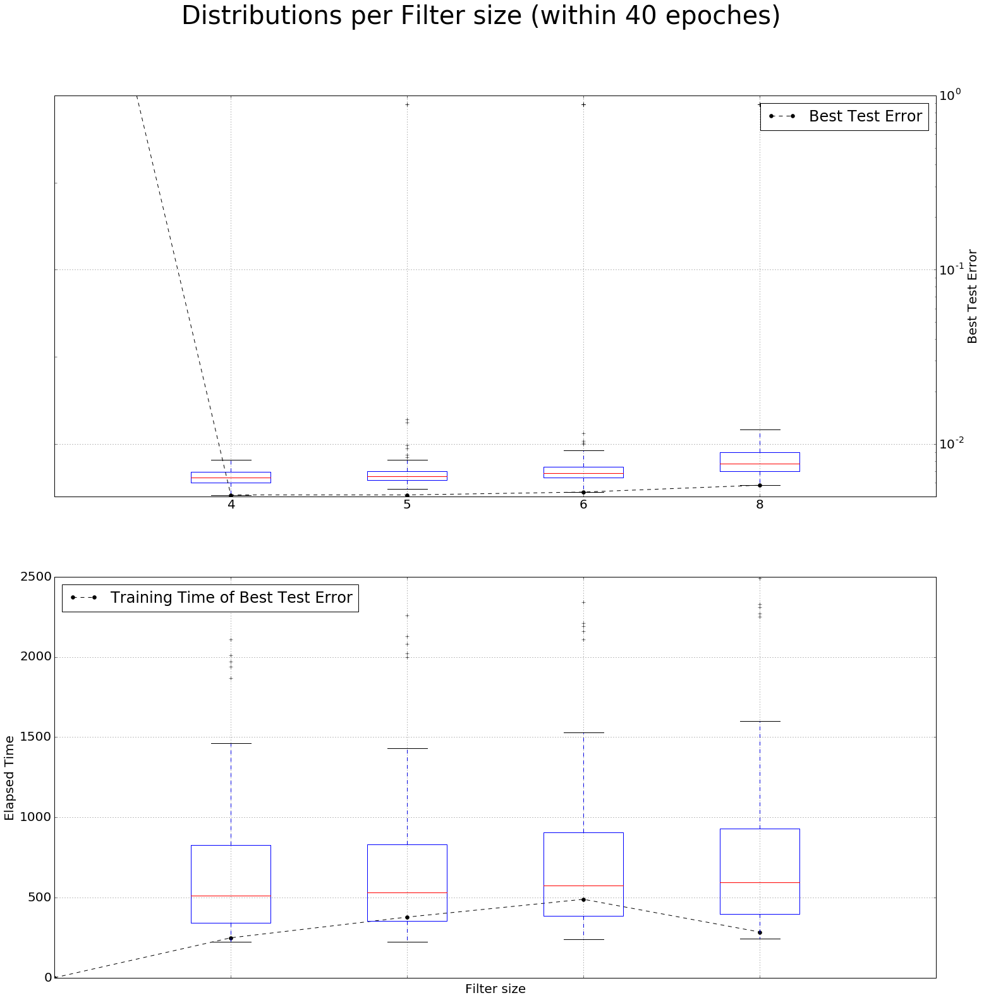

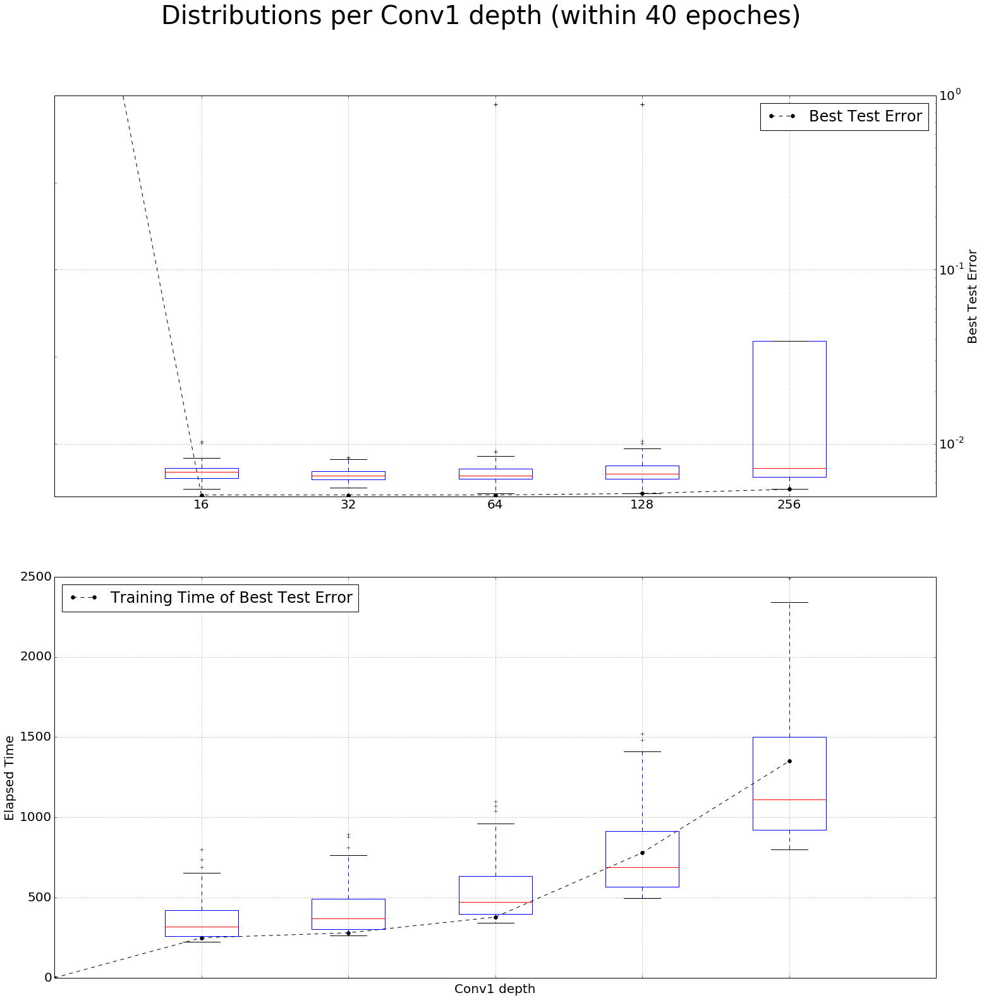

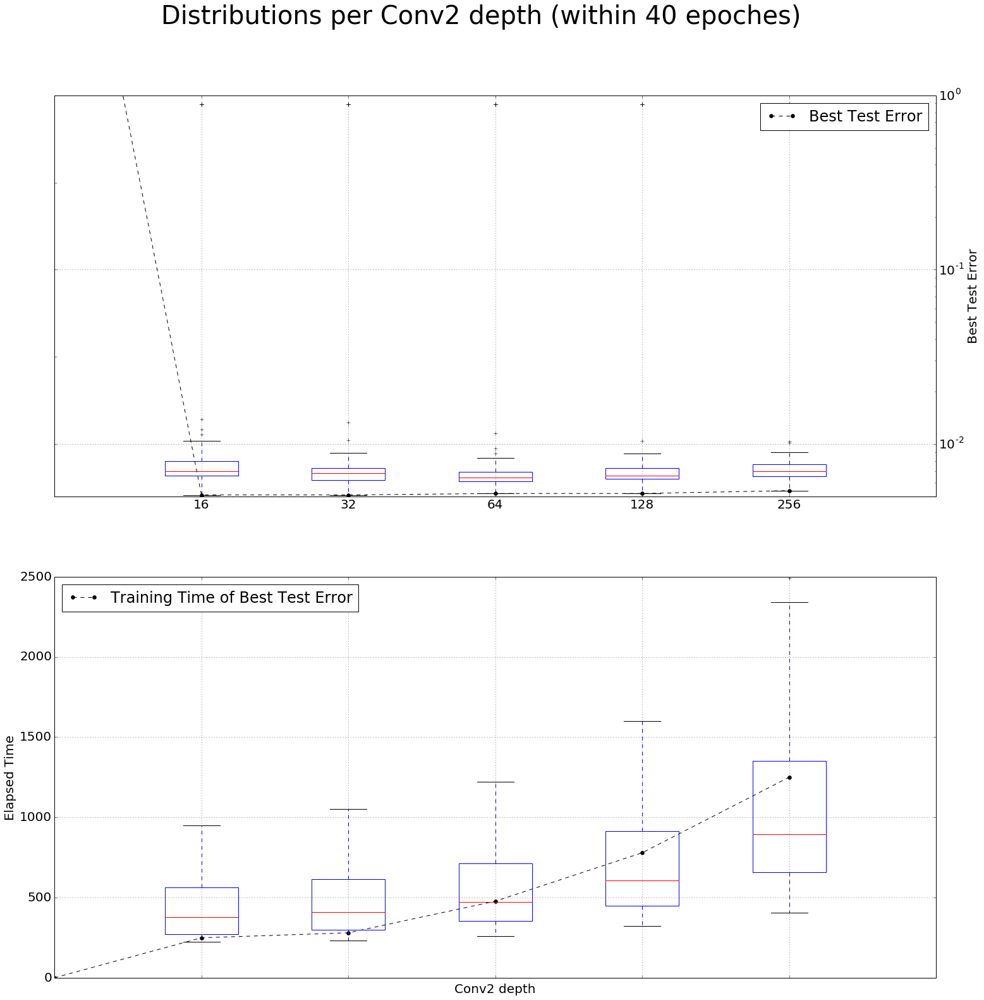

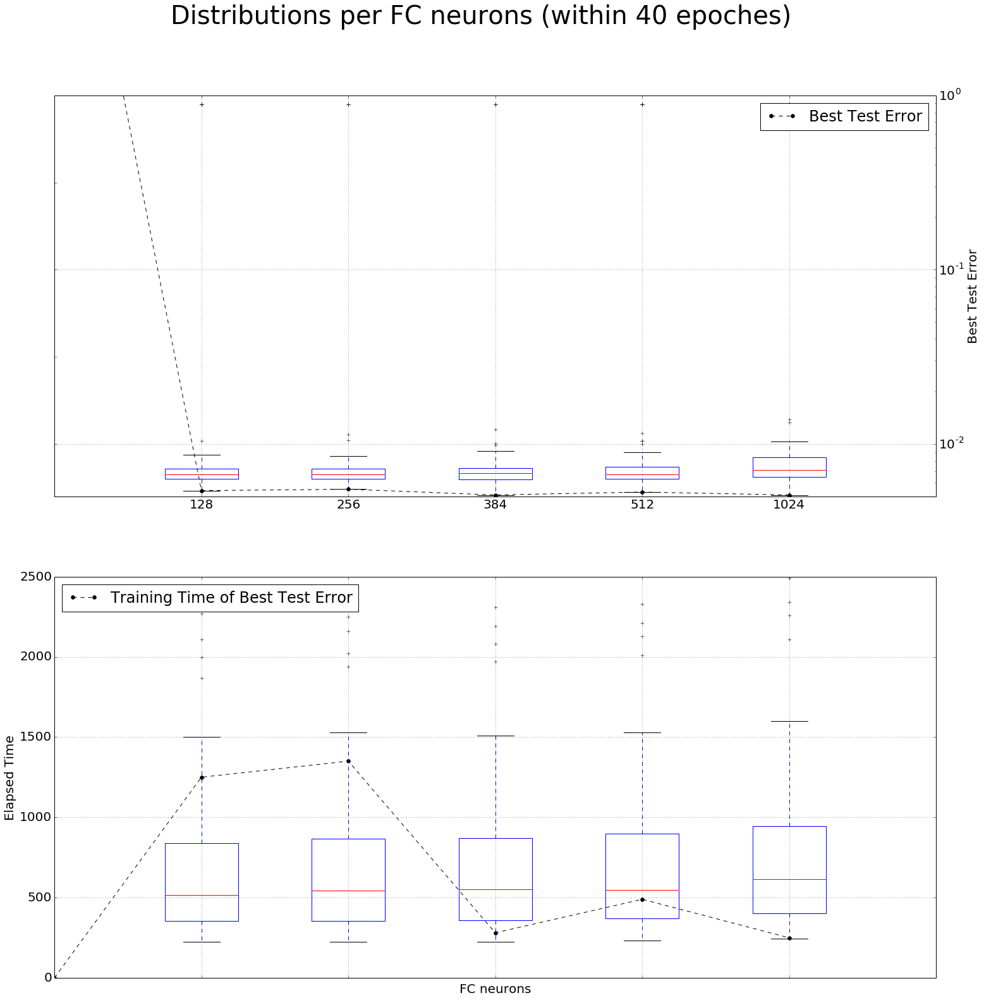

In [29]:
best_error_list2 = create_best_error_list(epoch40_all_table)
total_only_table3 = create_subset_table(epoch40_all_table, "total")
merged_table2 = create_best_error_table(best_error_list2, total_only_table3)
selected_dims = ["Filter size", "Conv1 depth", "Conv2 depth", "FC neurons"]
for selected_dim in selected_dims:
    draw_summary_plot(merged_table2, selected_dim, "Distributions per " + selected_dim + " (within 40 epoches)")

In [30]:
# modified version (Test Error is transformated by log 10 scale)
def draw_n_by_n_plots(table, fixed, x_axis, y_axis, selected_dim, output, show_fig=False, save_fig=True, to_log_scale=True):
    condition = {}
    condition[fixed["name"]] = fixed["value"]

    fig = plt.figure(num=None, figsize=(50, 50), dpi=200, facecolor='w', edgecolor='k')
    fig.suptitle("Fixed hyperparameter - " + fixed["name"] + ": " + str(fixed["value"]), fontsize=50)
    fig_index = 1
    
    if output == "Elapsed Time":
        # for fixed output range setting
        condition[x_axis["name"]] = max(x_axis["values"])
        condition[y_axis["name"]] = max(y_axis["values"])
        one_dim_table = get_one_dim(table, condition, selected_dim, output)
        y_range = [0, max(one_dim_table[output])] 
        y_col_name = output
    elif output == "Test Error":
        y_range = [log(0.001, 10), log(1, 10)] # 0 - 1 scale
        y_col_name = "log10(" + output + ")"
    else:
        print("unsupported output type")
    
    x_axis_length = len(x_axis["values"])
    y_axis_length = len(y_axis["values"])
    for i in range(x_axis_length):
        condition[x_axis["name"]] = x_axis["values"][i]
        for j in range(y_axis_length):
            subplot = fig.add_subplot(x_axis_length, y_axis_length, fig_index)
            fig_index += 1
            condition[y_axis["name"]] = y_axis["values"][j]
            
            one_dim_table = get_one_dim(table, condition, selected_dim, output)
            # print(one_dim_table.head(10)) # for debugging 
            x_col_name = selected_dim
            # To show log scale
            if to_log_scale:
                logscale_col = "log2(" + selected_dim + ")"
                x_col_name = logscale_col
                
            subplot.plot(one_dim_table[x_col_name], one_dim_table[y_col_name])
            title = x_axis["name"] + ":" + str(condition[x_axis["name"]]) + ", " + \
                y_axis["name"] + ":" + str(condition[y_axis["name"]])
            subplot.set_title(title)
            subplot.set_ylim(y_range)
            if j == 0:
                plt.ylabel(y_col_name)

            if j == 0:
                plt.xlabel(x_col_name)

    if show_fig:
        plt.show()
    if save_fig:
        working_dir = os.getcwd()
        file_name = fixed["name"] + "_" + str(condition[fixed["name"]]) + '-' + output + '.png'
        file_name = file_name.replace(" ", "_")
        output_folder = output.replace(" ", "_")
        selected_dim_folder = selected_dim.replace(" ", "_")
        #print (output_folder)
        #print (selected_dim_folder)
        try:
            os.chdir("epoch_10")
            if not os.path.exists(output_folder):
                os.makedirs(output_folder)
                #print(output_folder + " is created")
                
            os.chdir(output_folder)

            if not os.path.exists(selected_dim_folder):
                os.makedirs(selected_dim_folder)
                
            os.chdir(selected_dim_folder)
        except OSError as exception:
            print("folder creation error: " + str(exception))
            os.chdir(working_dir)
            
        fig.savefig(file_name, format='png', dpi=200, show=False)
        os.chdir(working_dir)
        print(file_name + " is saved successfully.")
        
    return

Filter_size_2-Elapsed_Time.png is saved successfully.
Filter_size_2-Test_Error.png is saved successfully.
Filter_size_4-Elapsed_Time.png is saved successfully.
Filter_size_4-Test_Error.png is saved successfully.
Filter_size_6-Elapsed_Time.png is saved successfully.
Filter_size_6-Test_Error.png is saved successfully.
Filter_size_8-Elapsed_Time.png is saved successfully.
Filter_size_8-Test_Error.png is saved successfully.
Filter_size_10-Elapsed_Time.png is saved successfully.
Filter_size_10-Test_Error.png is saved successfully.
Filter_size_12-Elapsed_Time.png is saved successfully.
Filter_size_12-Test_Error.png is saved successfully.
Filter_size_14-Elapsed_Time.png is saved successfully.
Filter_size_14-Test_Error.png is saved successfully.


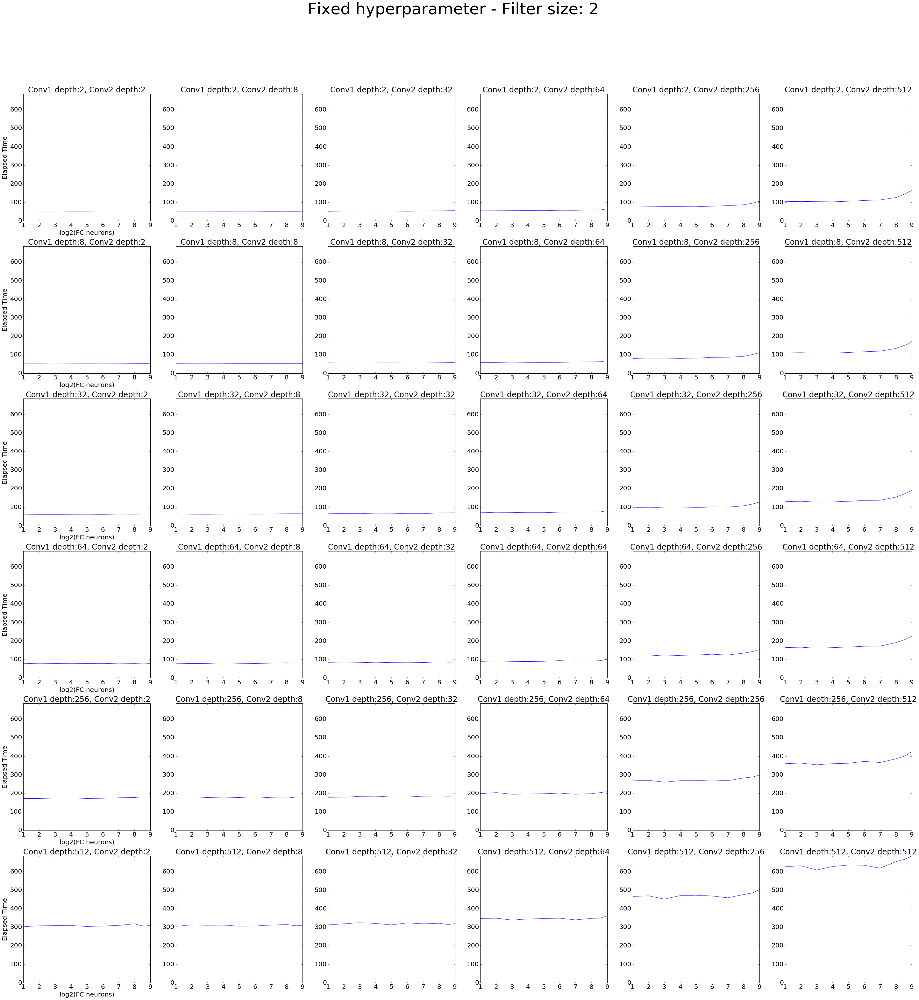

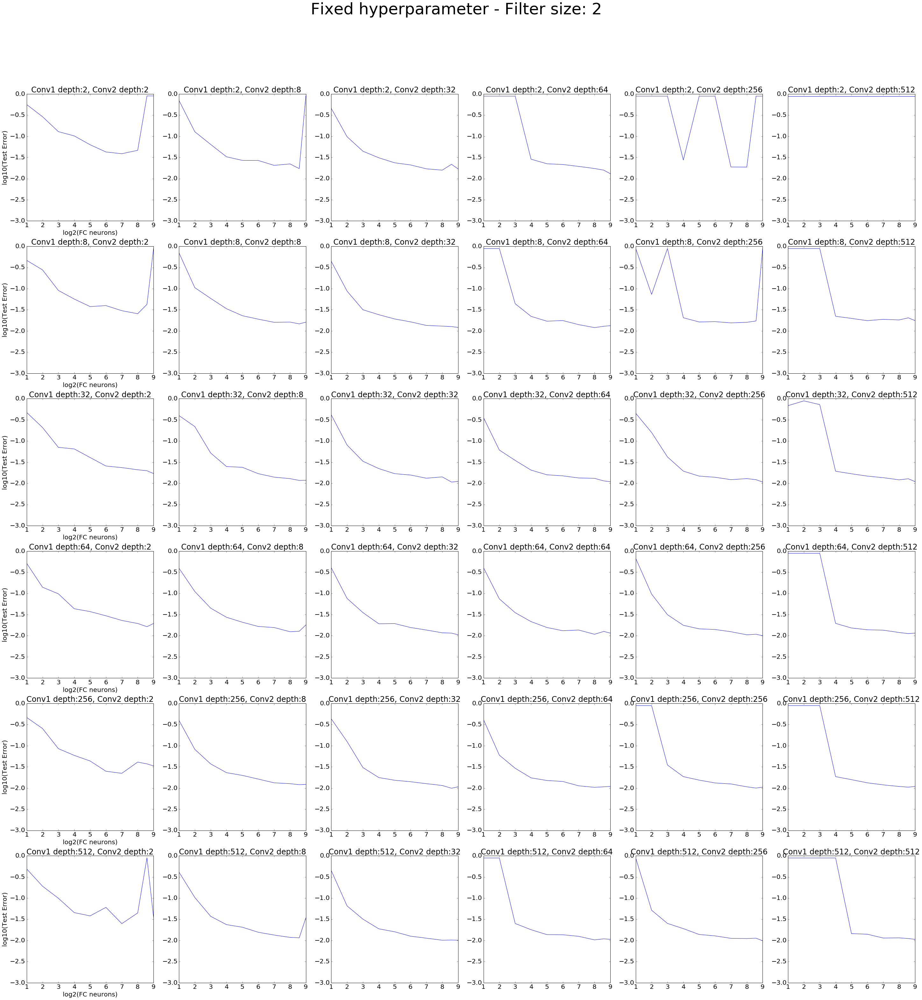

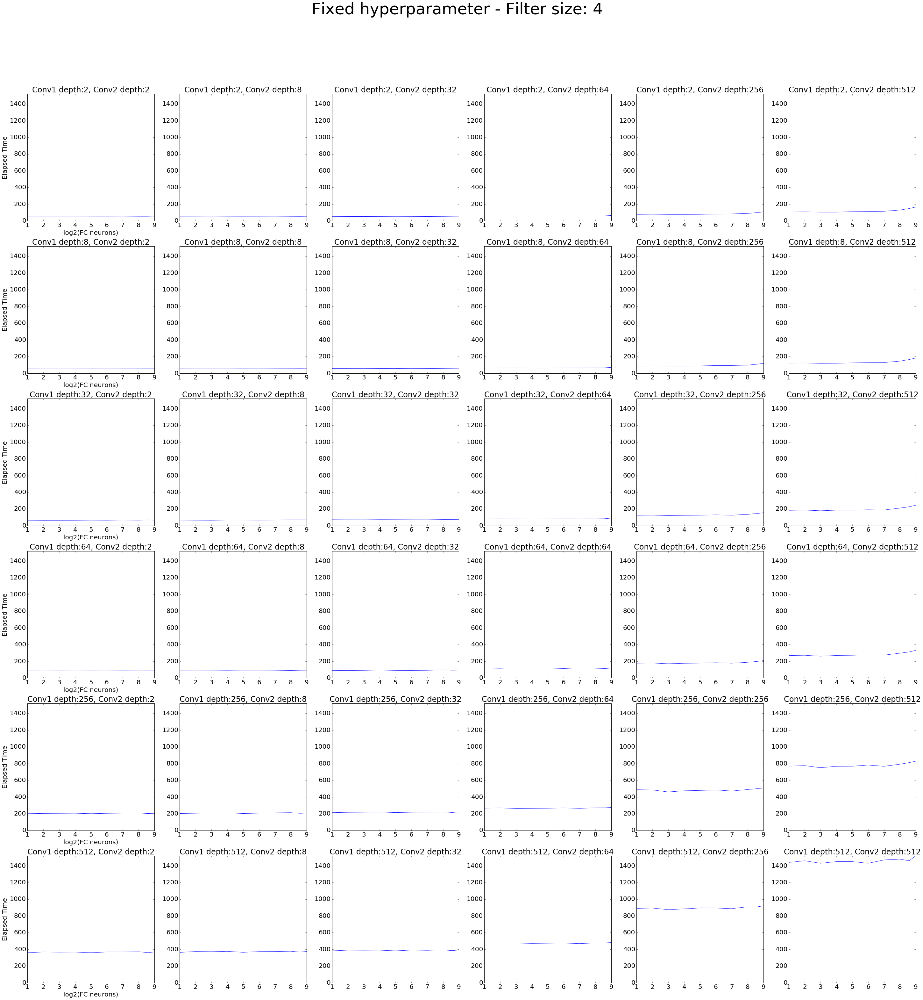

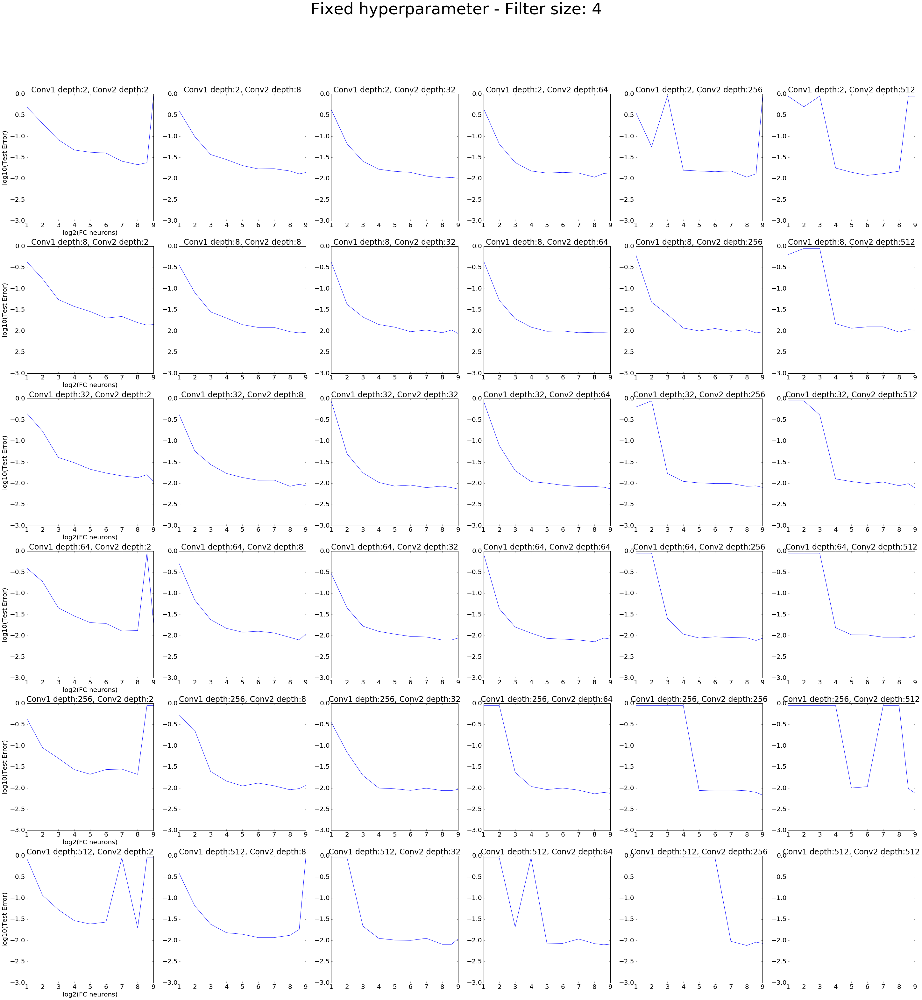

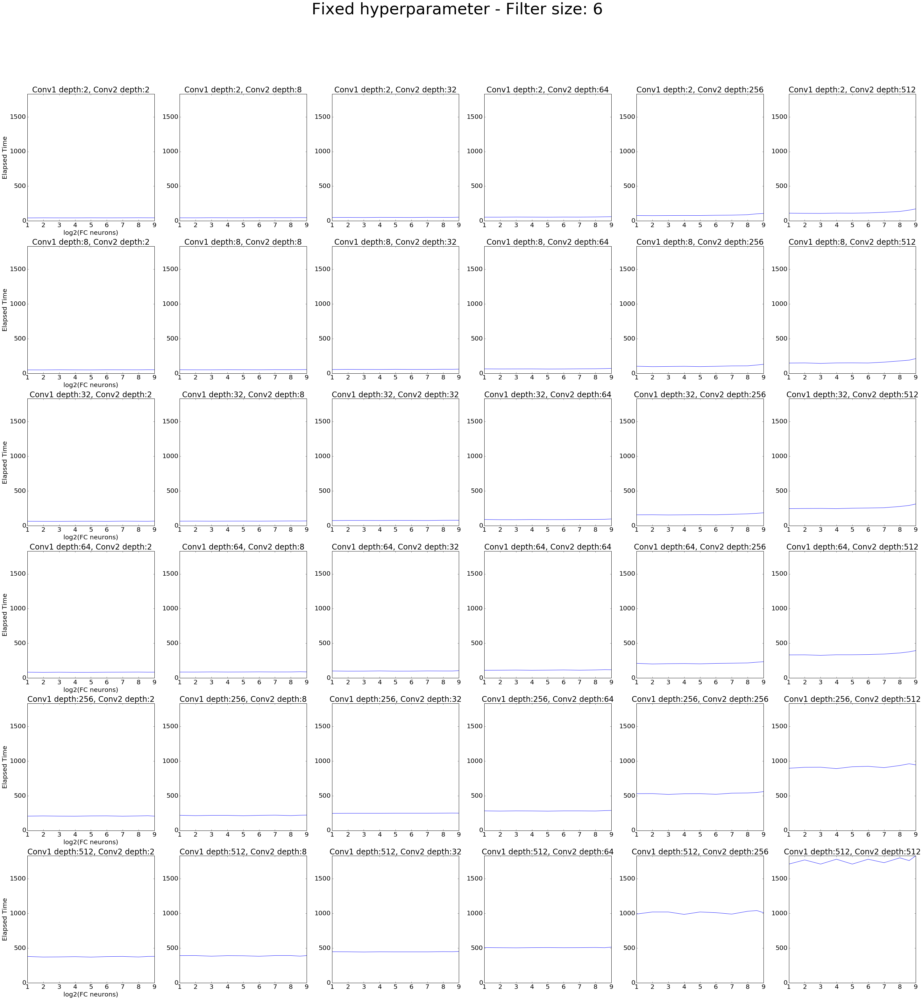

...

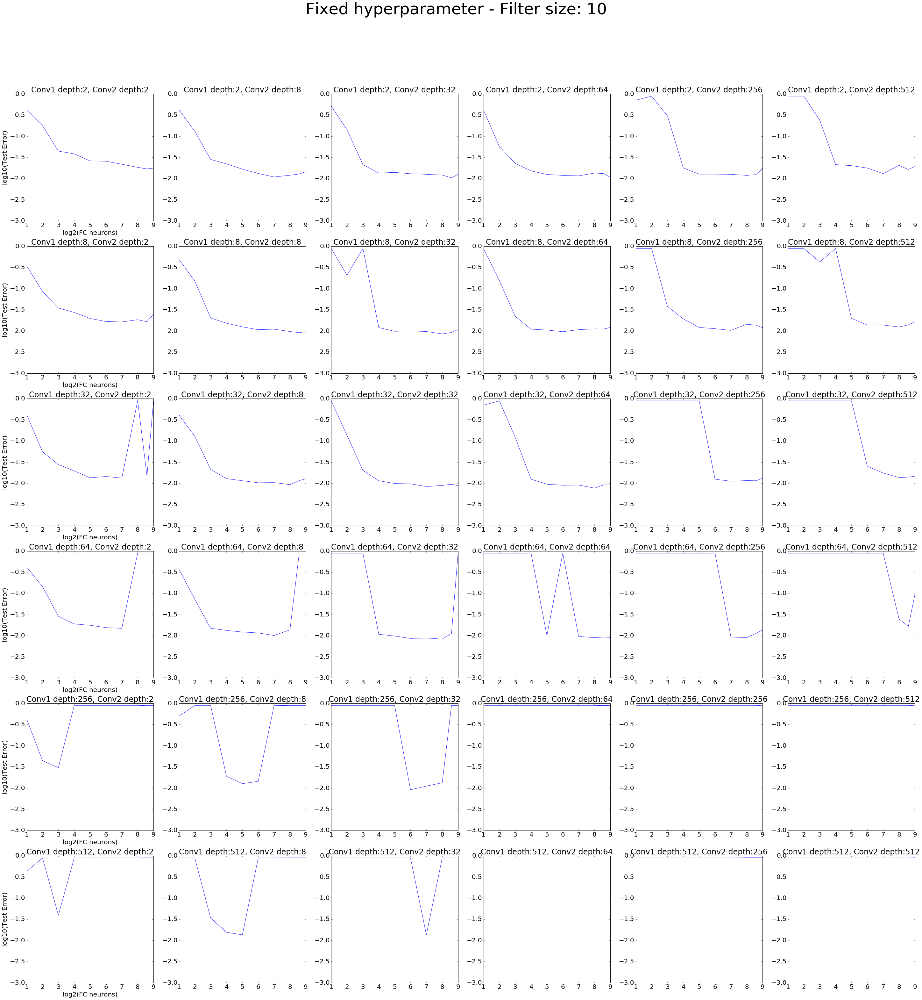

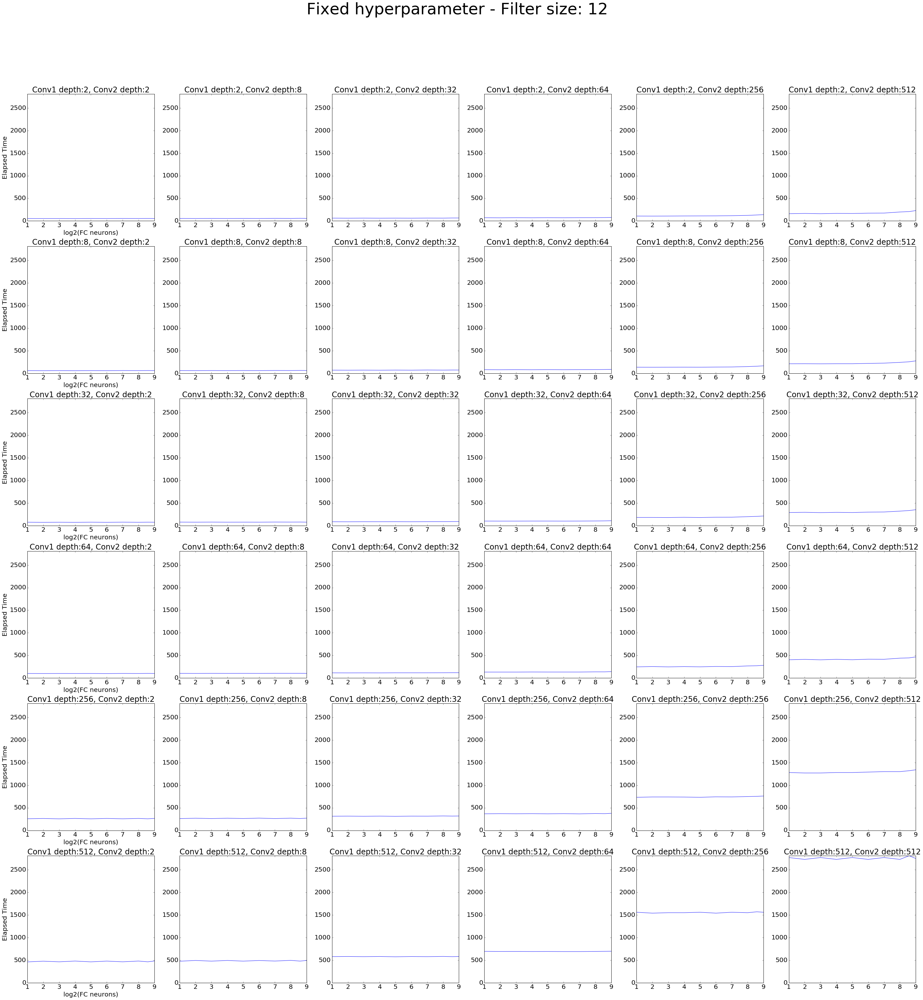

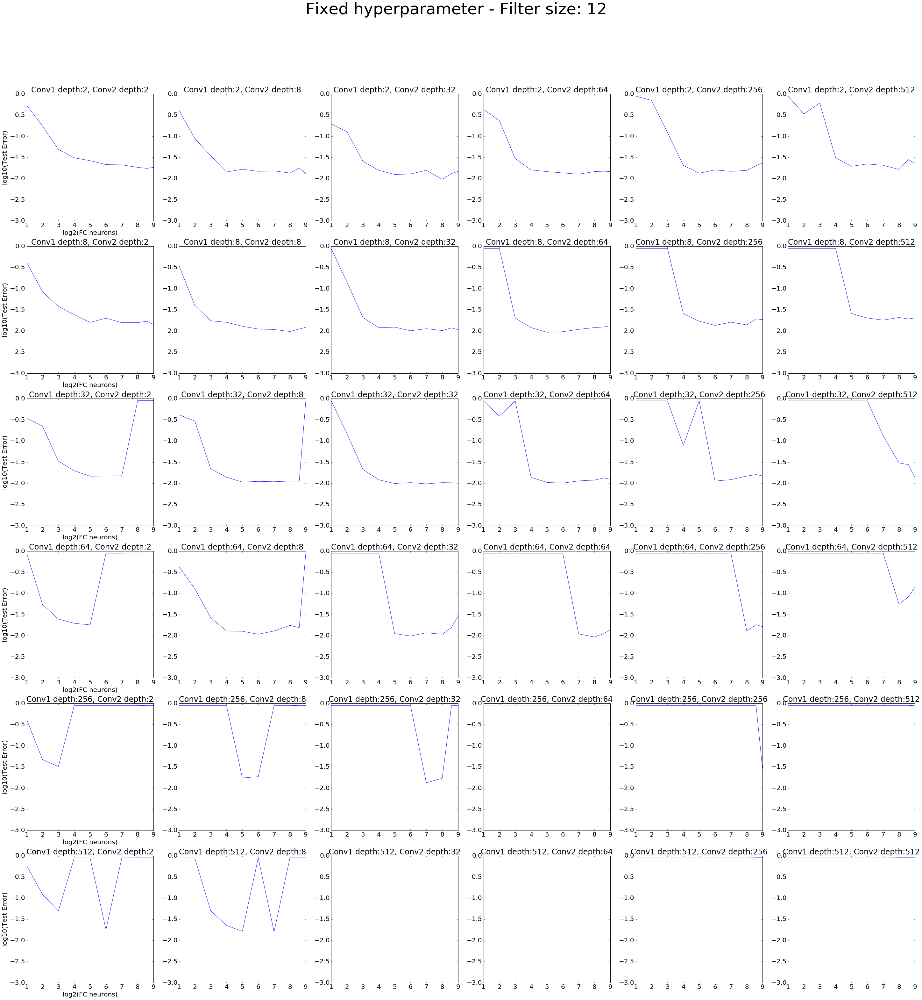

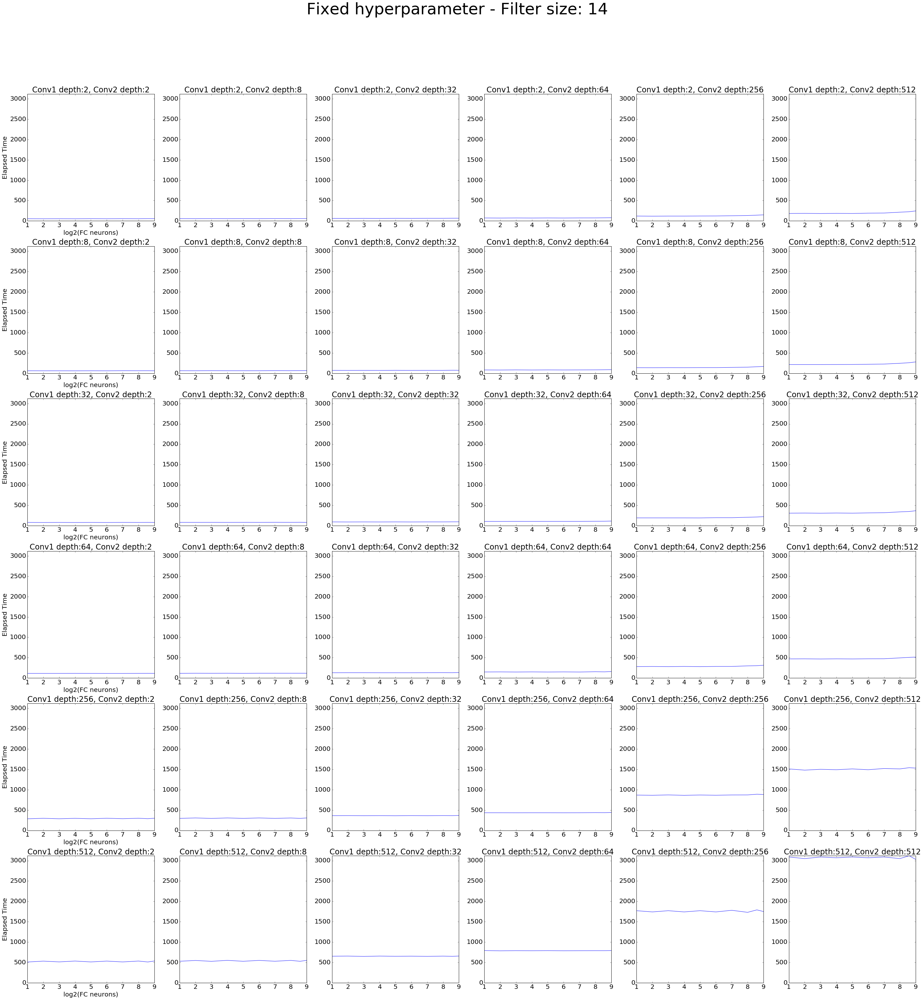

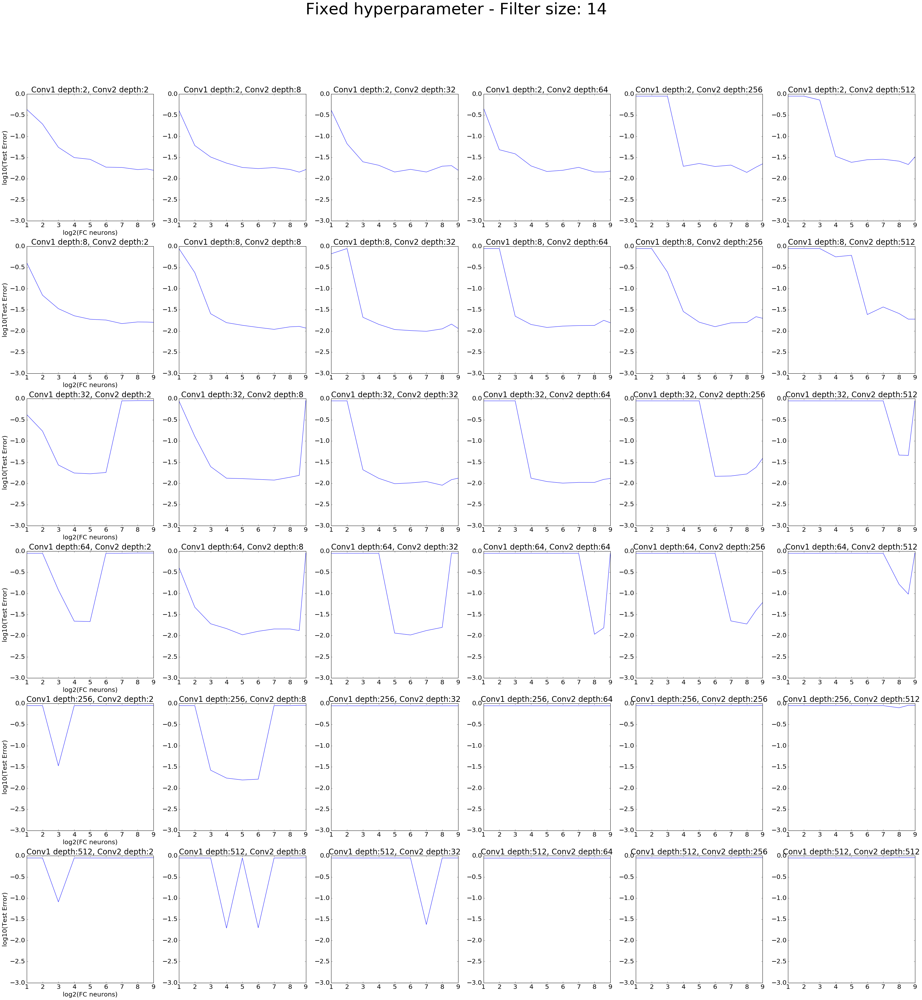

In [31]:
filter_sizes = [2, 4, 6, 8, 10, 12, 14]

#conv1_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
#conv2_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
conv1_list = [2, 8, 32, 64, 256, 512]
conv2_list = [2, 8, 32, 64, 256, 512]
x_axis = {"name" : "Conv1 depth", "values" : conv1_list}
y_axis = {"name" : "Conv2 depth", "values" : conv2_list}
outputs = ["Elapsed Time", "Test Error"]
selected_dim = "FC neurons"

for f in filter_sizes:
    for output in outputs:
        fixed = {"name": "Filter size", "value": f}
        draw_n_by_n_plots(total_only_table, fixed, x_axis, y_axis, selected_dim, output, False, True)

FC_neurons_2-Elapsed_Time.png is saved successfully.
FC_neurons_2-Test_Error.png is saved successfully.
FC_neurons_8-Elapsed_Time.png is saved successfully.
FC_neurons_8-Test_Error.png is saved successfully.
FC_neurons_32-Elapsed_Time.png is saved successfully.
FC_neurons_32-Test_Error.png is saved successfully.
FC_neurons_128-Elapsed_Time.png is saved successfully.
FC_neurons_128-Test_Error.png is saved successfully.
FC_neurons_384-Elapsed_Time.png is saved successfully.
FC_neurons_384-Test_Error.png is saved successfully.
FC_neurons_512-Elapsed_Time.png is saved successfully.
FC_neurons_512-Test_Error.png is saved successfully.


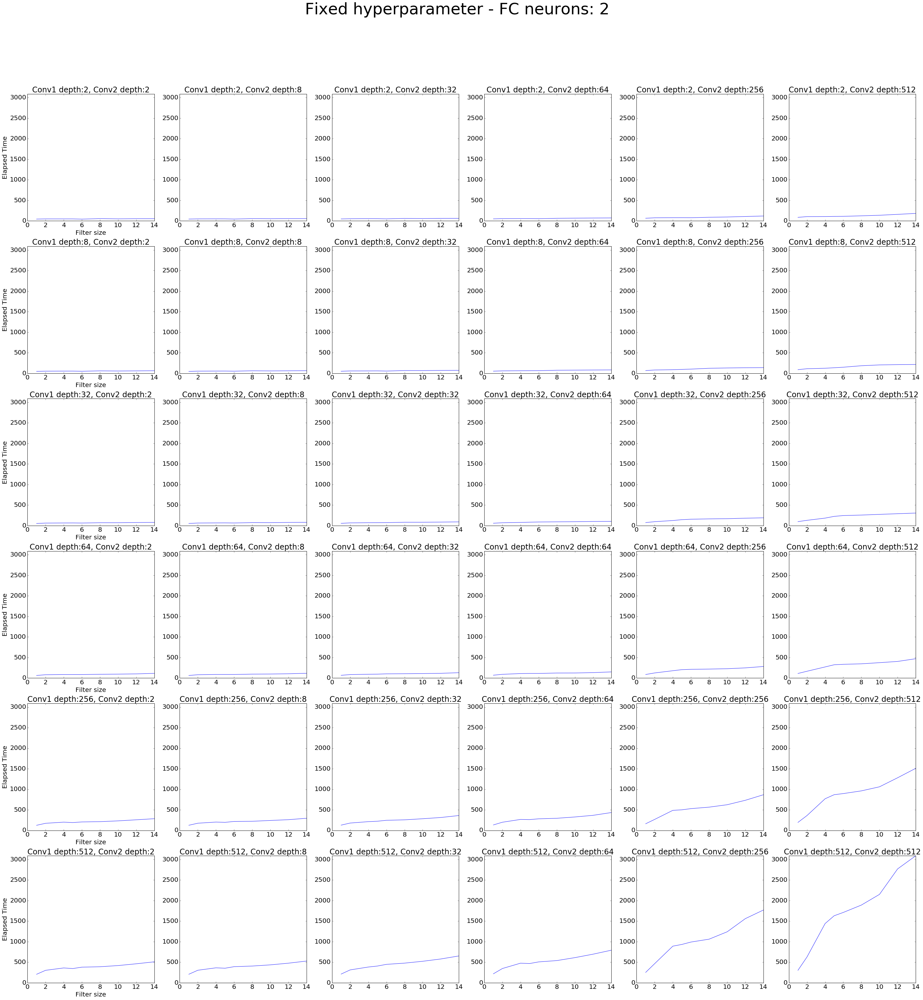

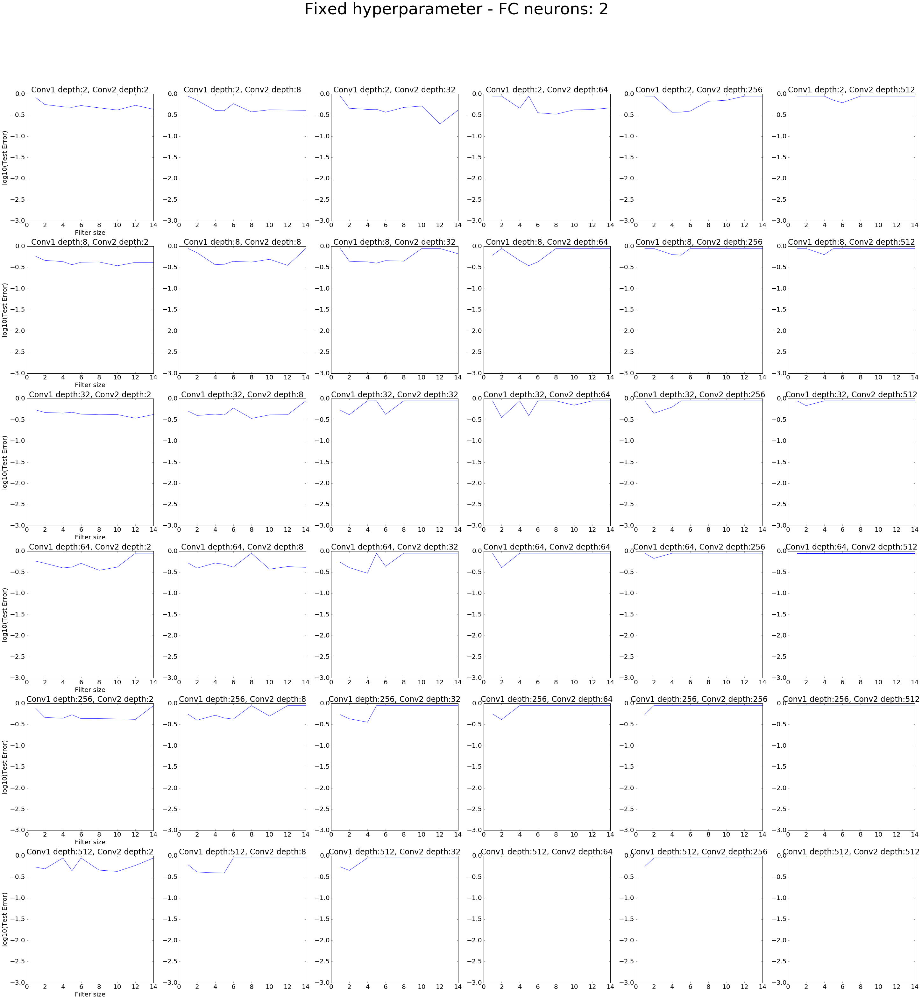

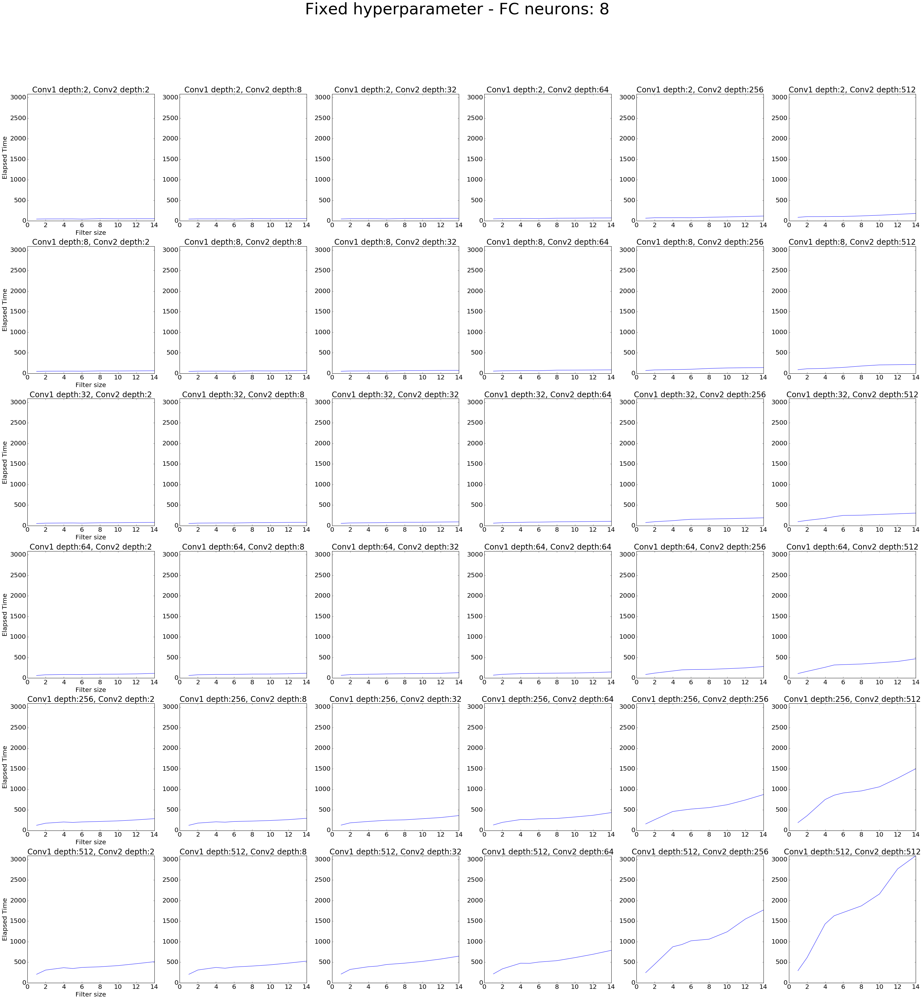

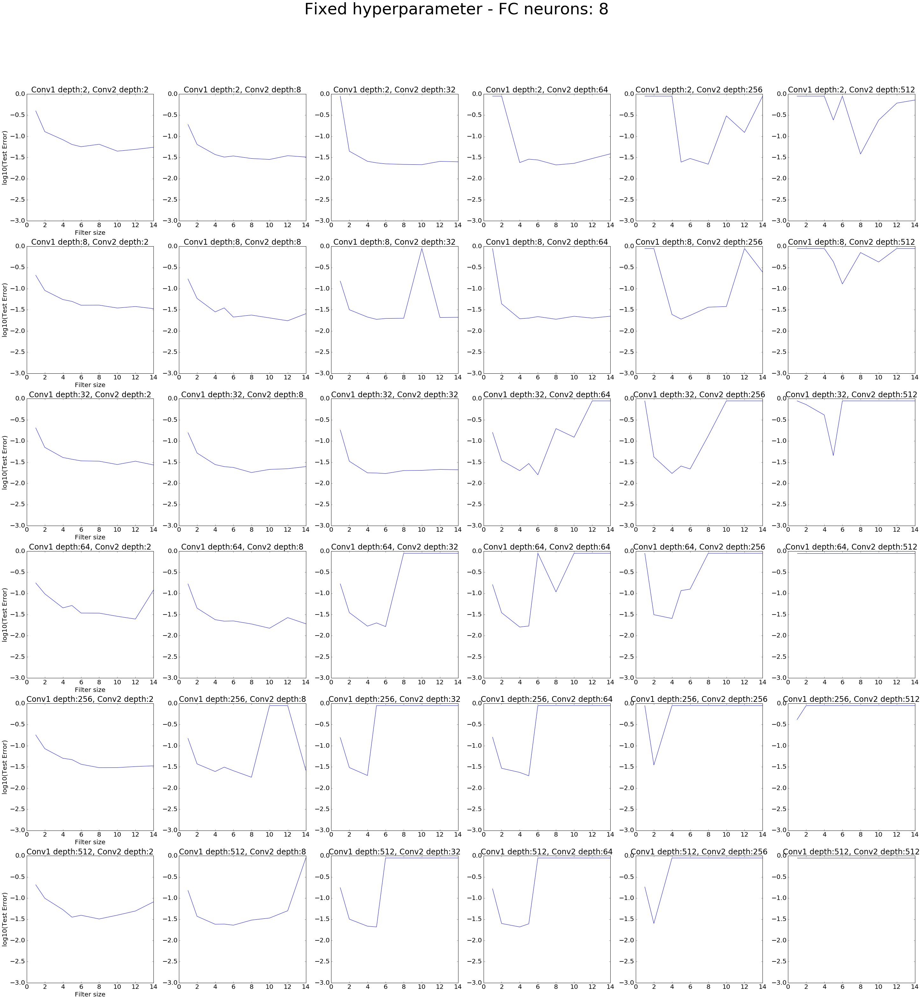

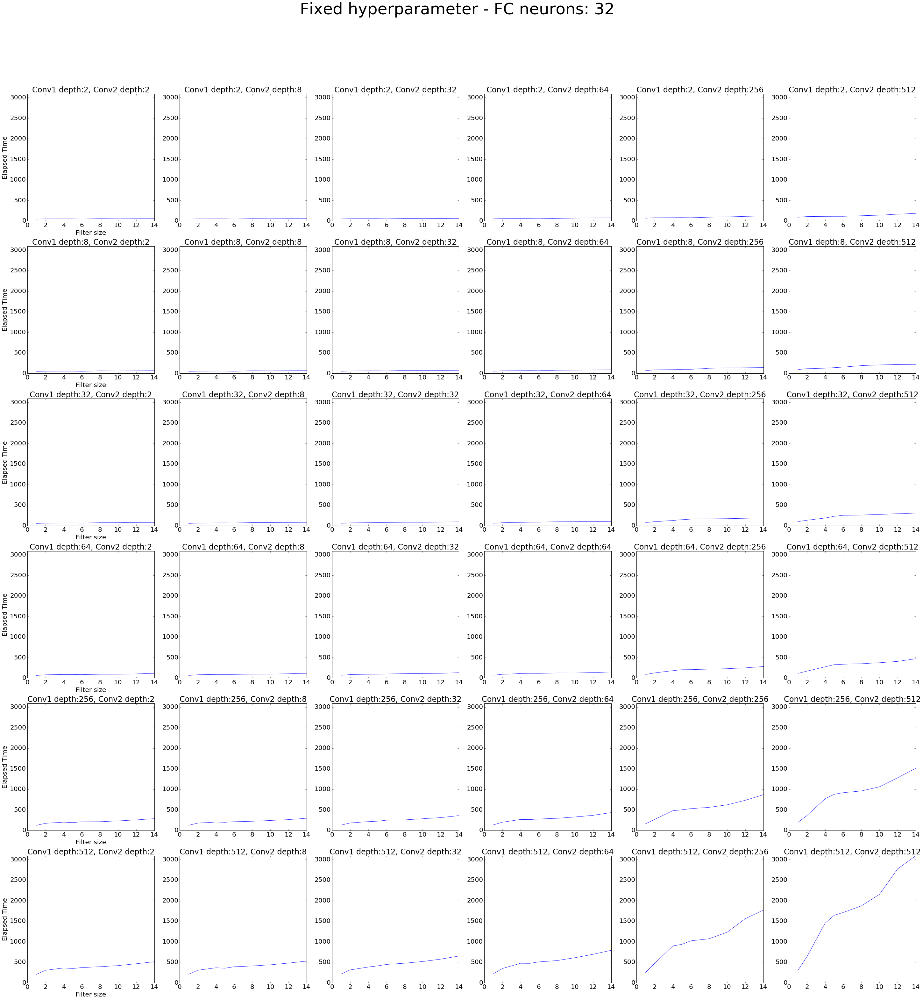

...

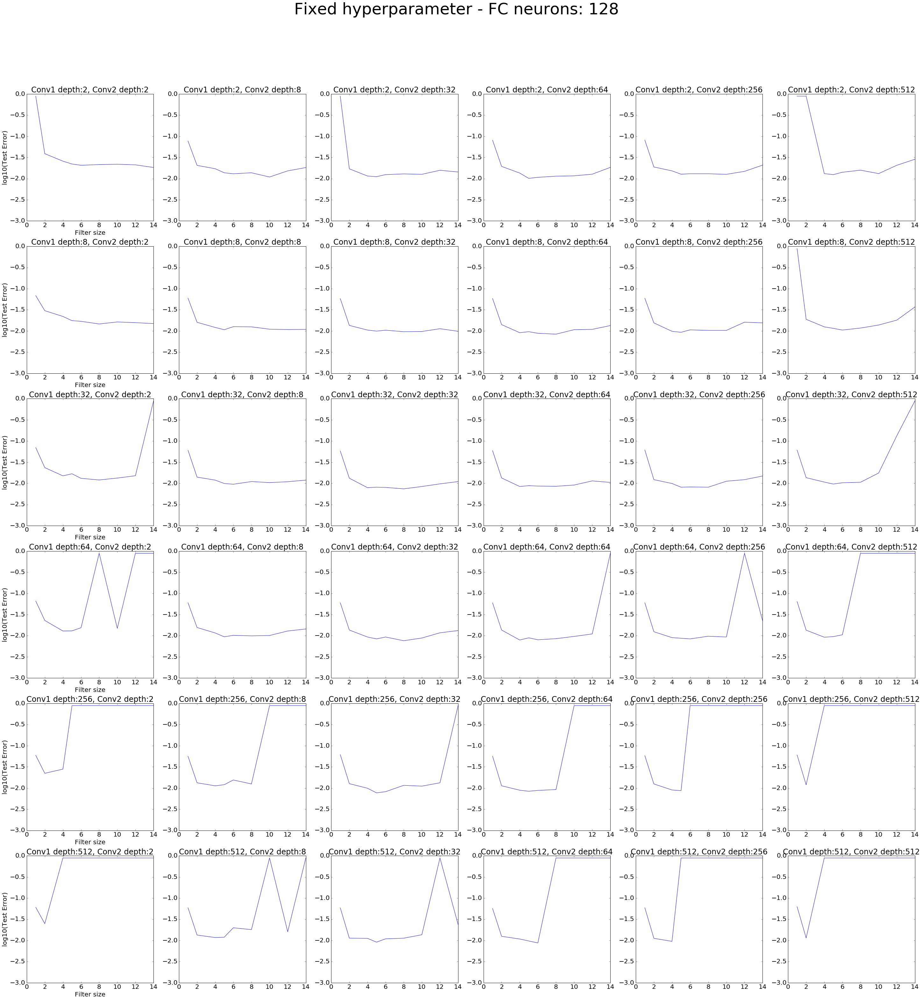

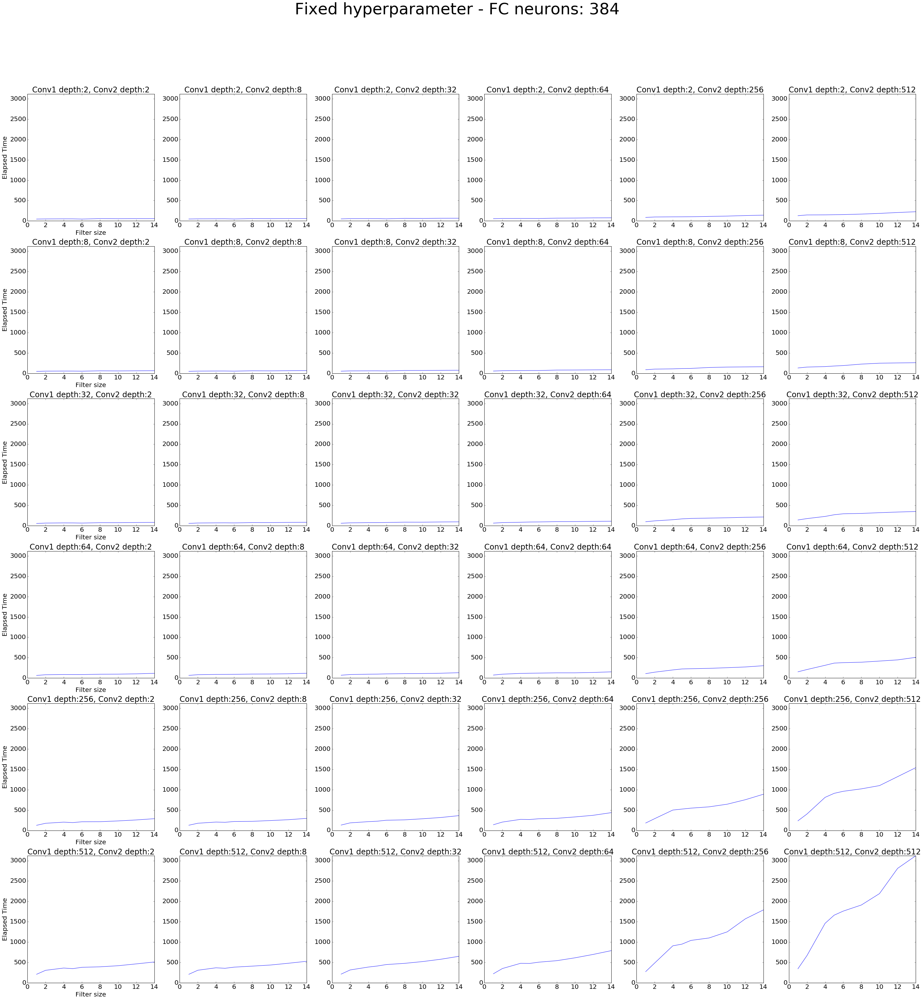

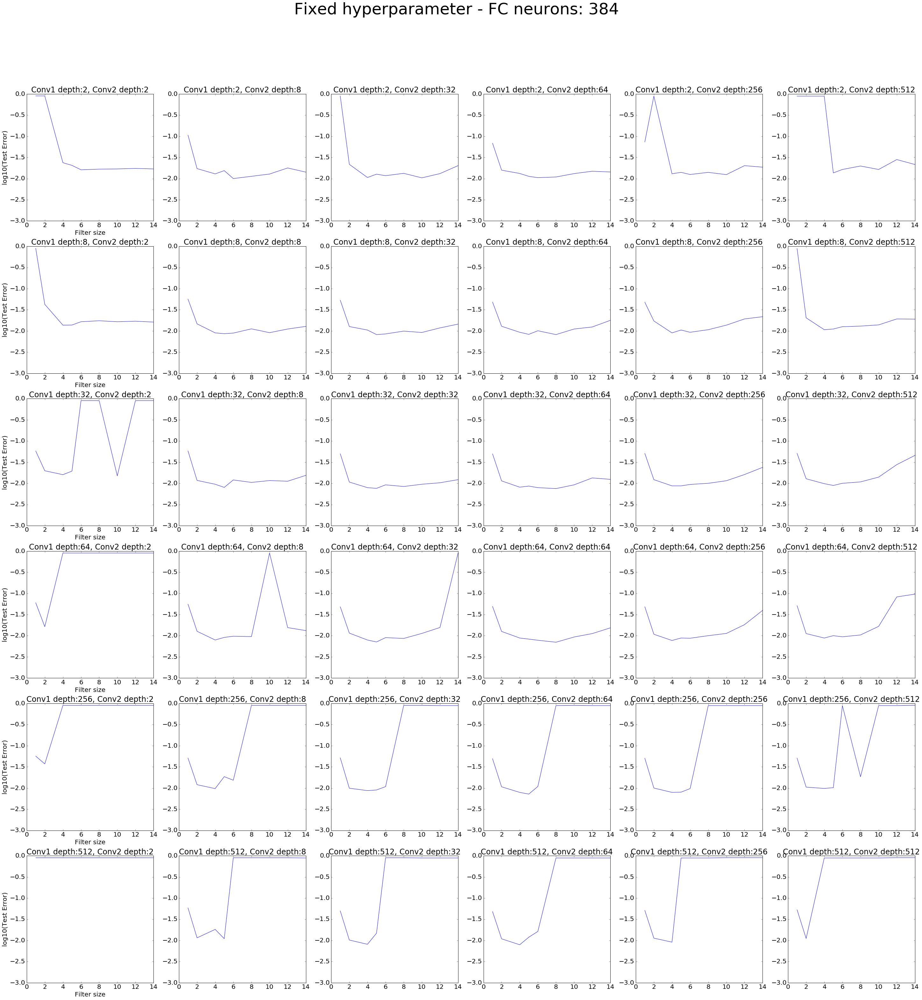

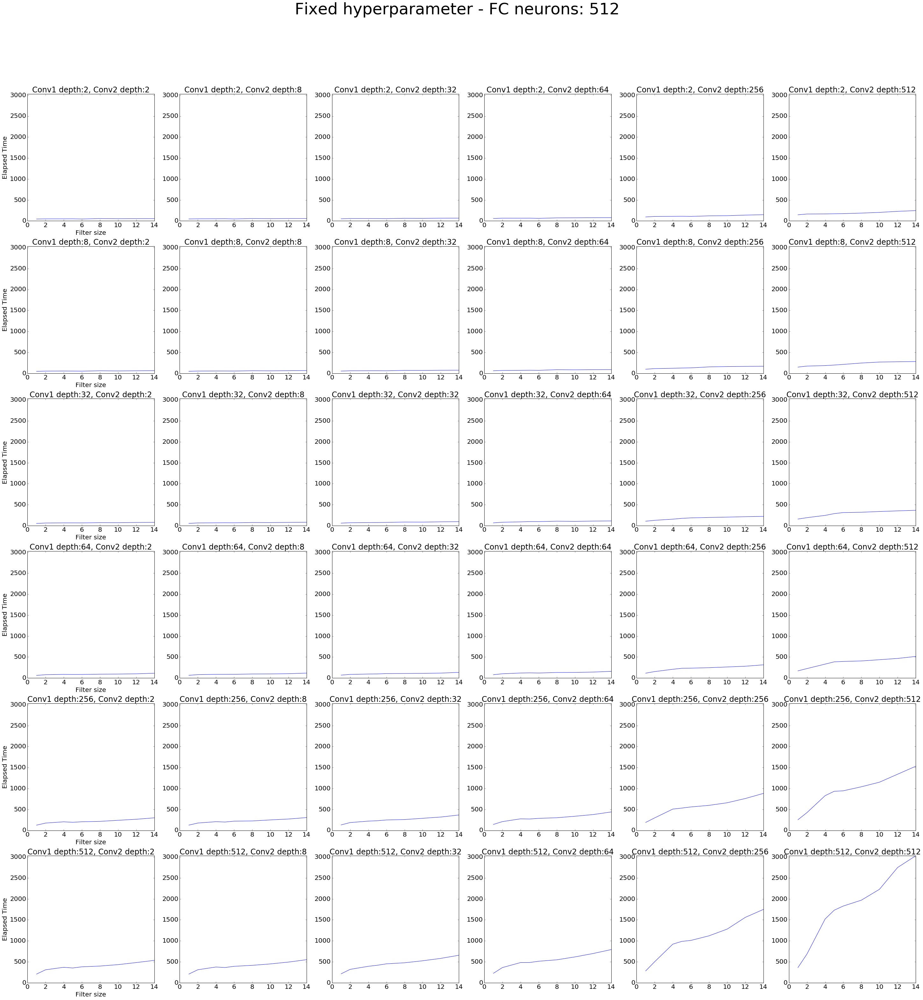

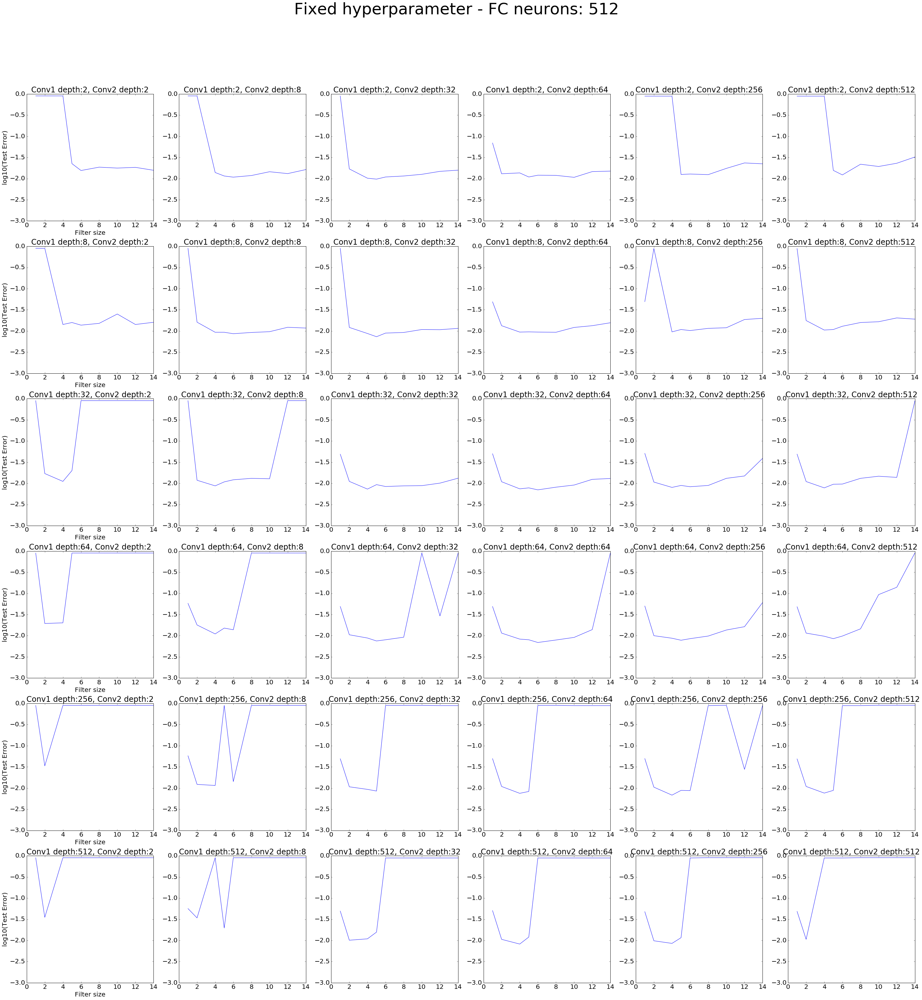

In [32]:
filter_sizes = [1, 2, 4, 6, 8, 10, 12, 14]
conv1_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
conv2_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
fc_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
conv1_list = [2, 8, 32, 64, 256, 512]
conv2_list = [2, 8, 32, 64, 256, 512]
fc_list = [2, 8, 32, 128, 384, 512]
x_axis = {"name" : "Conv1 depth", "values" : conv1_list}
y_axis = {"name" : "Conv2 depth", "values" : conv2_list}
outputs = ["Elapsed Time", "Test Error"]
selected_dim = "Filter size"

for fc in fc_list:
    for output in outputs:
        fixed = {"name": "FC neurons", "value": fc}
        draw_n_by_n_plots(total_only_table, fixed, x_axis, y_axis, selected_dim, output, False, True, False)

Conv2_depth_2-Elapsed_Time.png is saved successfully.
Conv2_depth_2-Test_Error.png is saved successfully.
Conv2_depth_8-Elapsed_Time.png is saved successfully.
Conv2_depth_8-Test_Error.png is saved successfully.
Conv2_depth_32-Elapsed_Time.png is saved successfully.
Conv2_depth_32-Test_Error.png is saved successfully.
Conv2_depth_64-Elapsed_Time.png is saved successfully.
Conv2_depth_64-Test_Error.png is saved successfully.
Conv2_depth_256-Elapsed_Time.png is saved successfully.
Conv2_depth_256-Test_Error.png is saved successfully.
Conv2_depth_512-Elapsed_Time.png is saved successfully.
Conv2_depth_512-Test_Error.png is saved successfully.


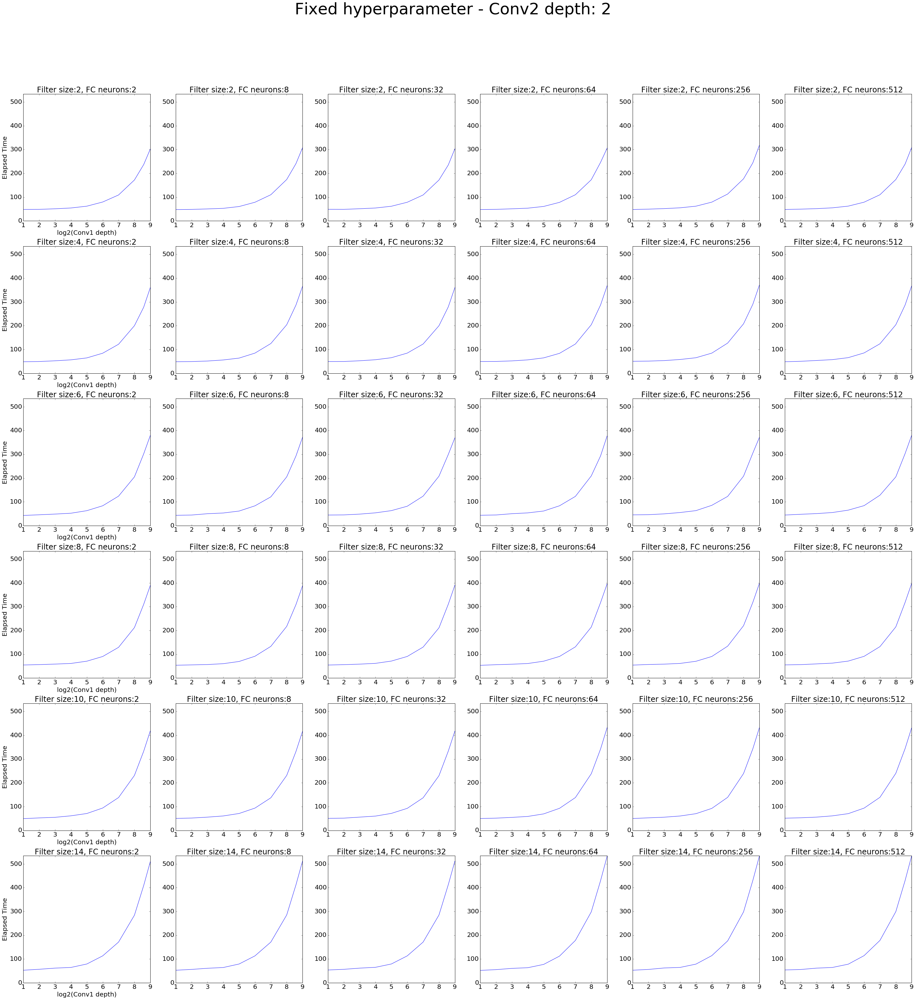

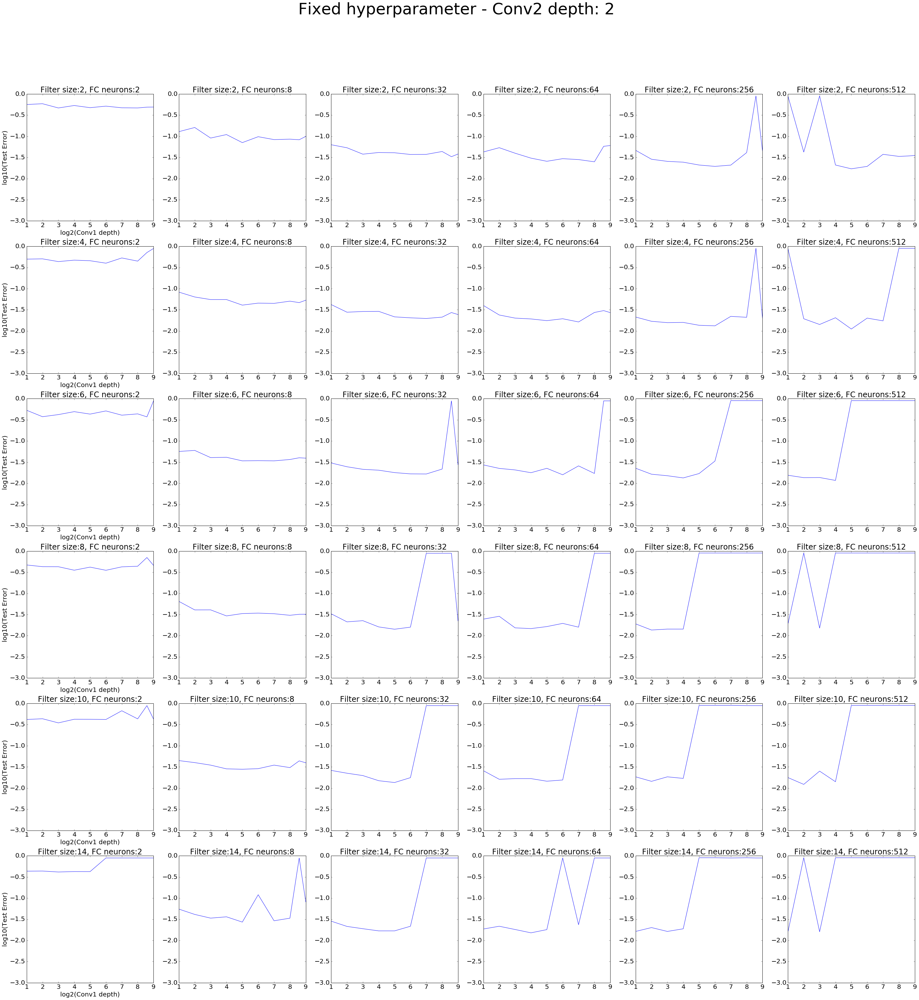

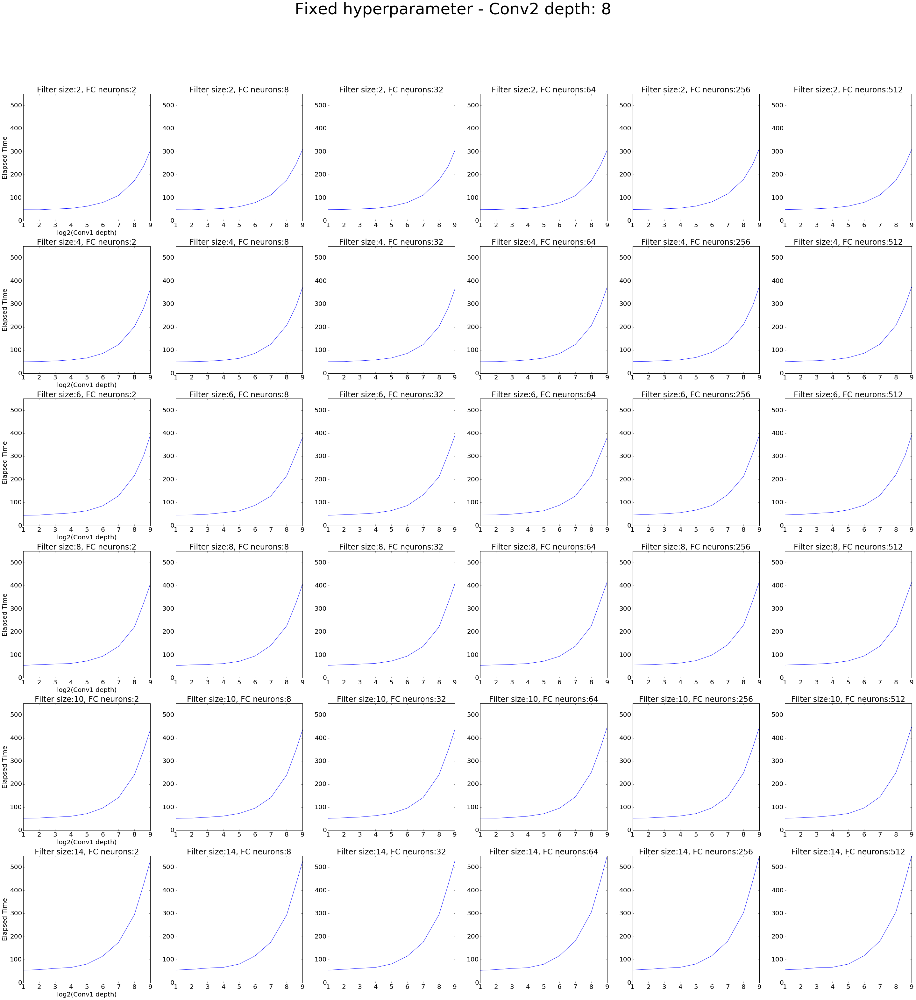

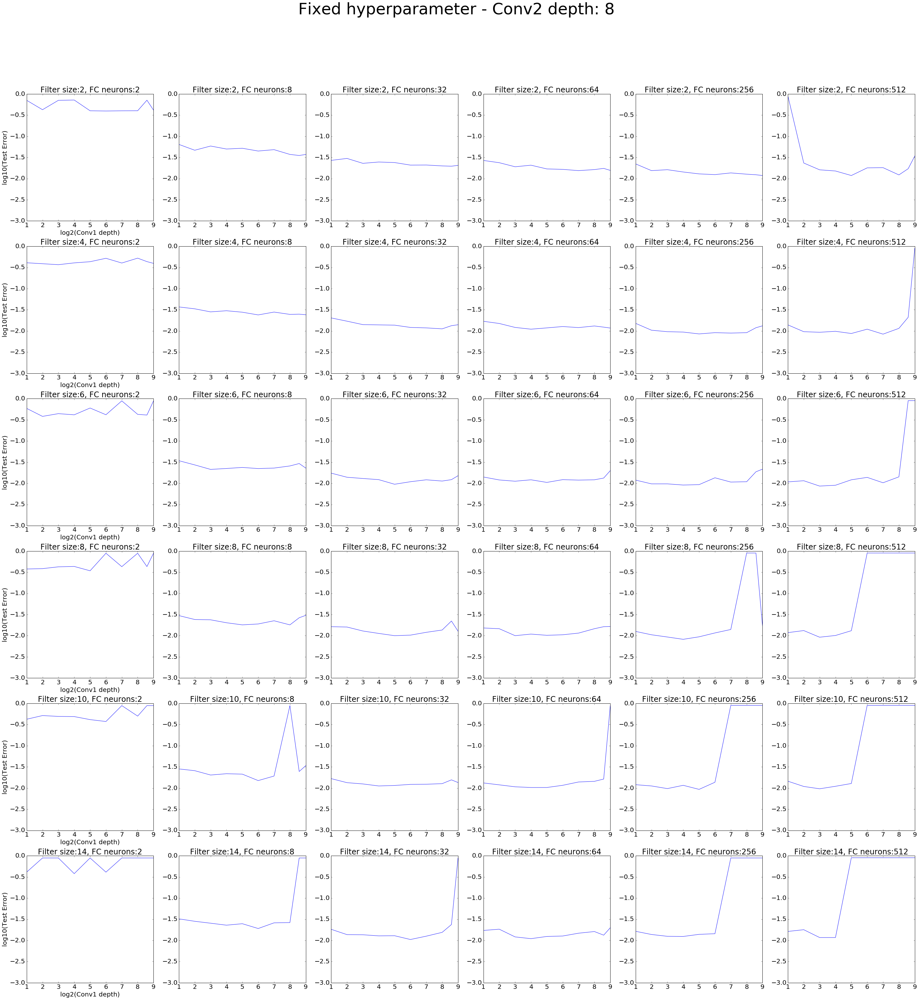

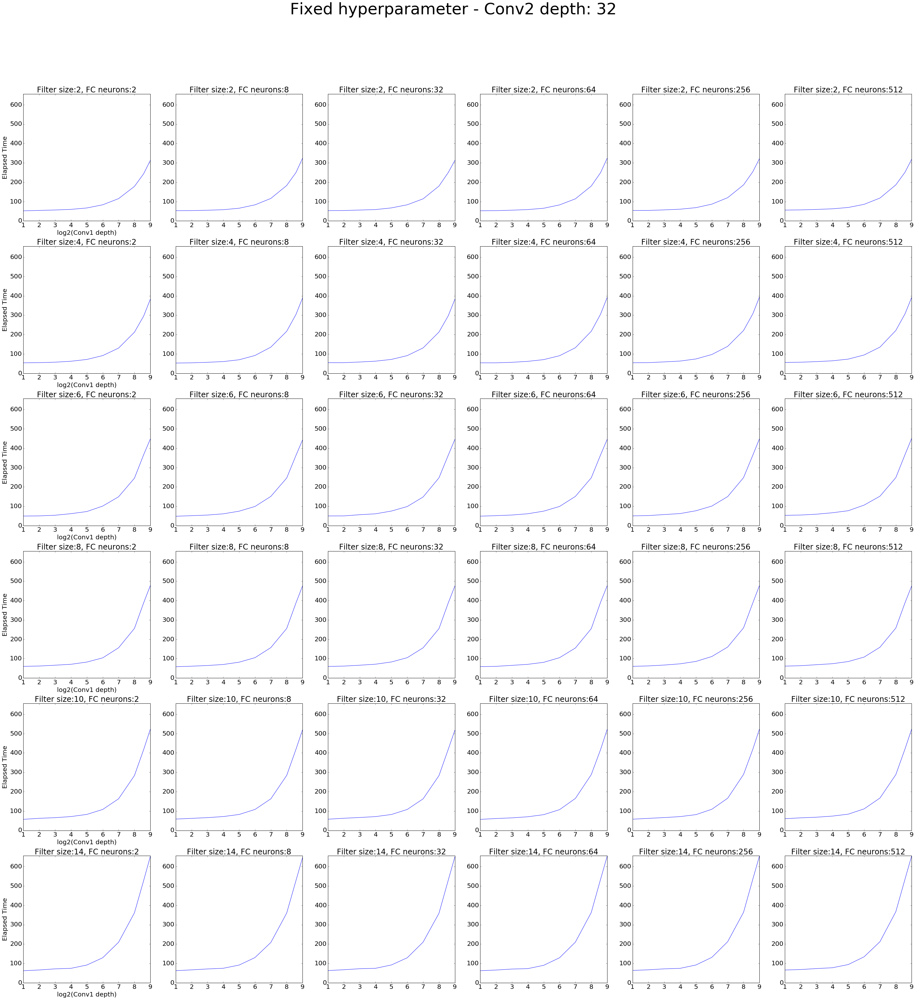

...

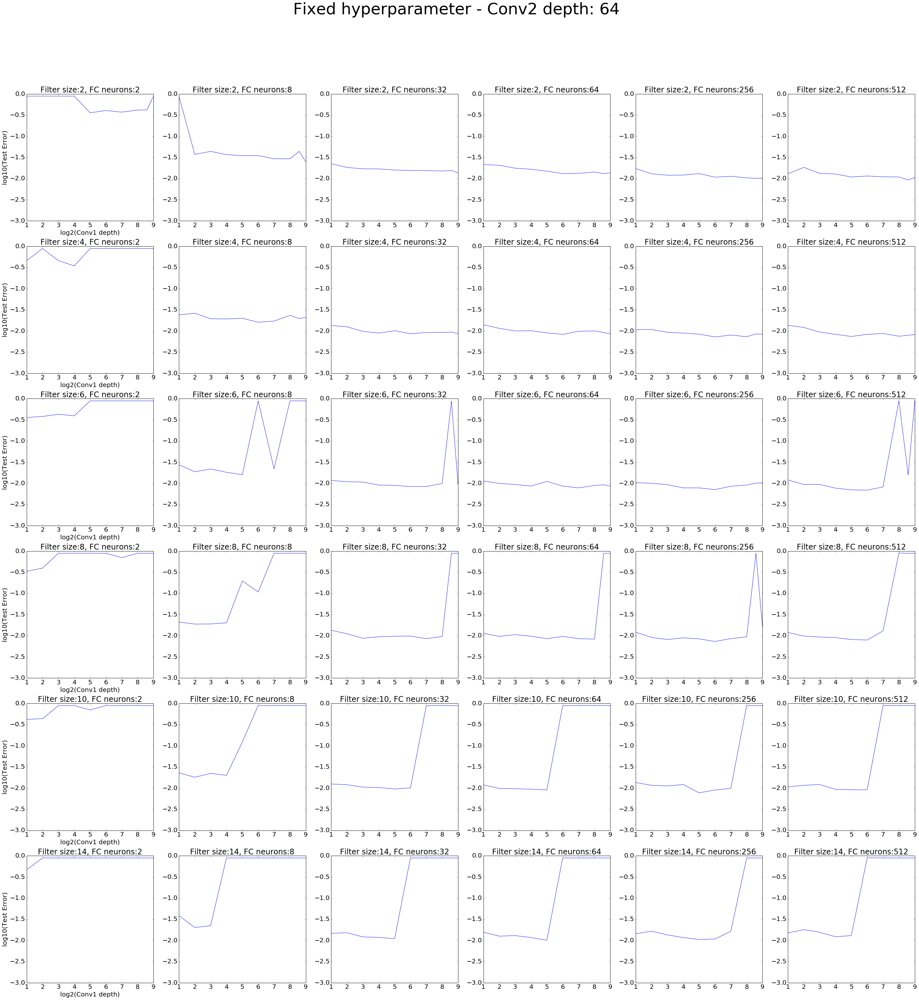

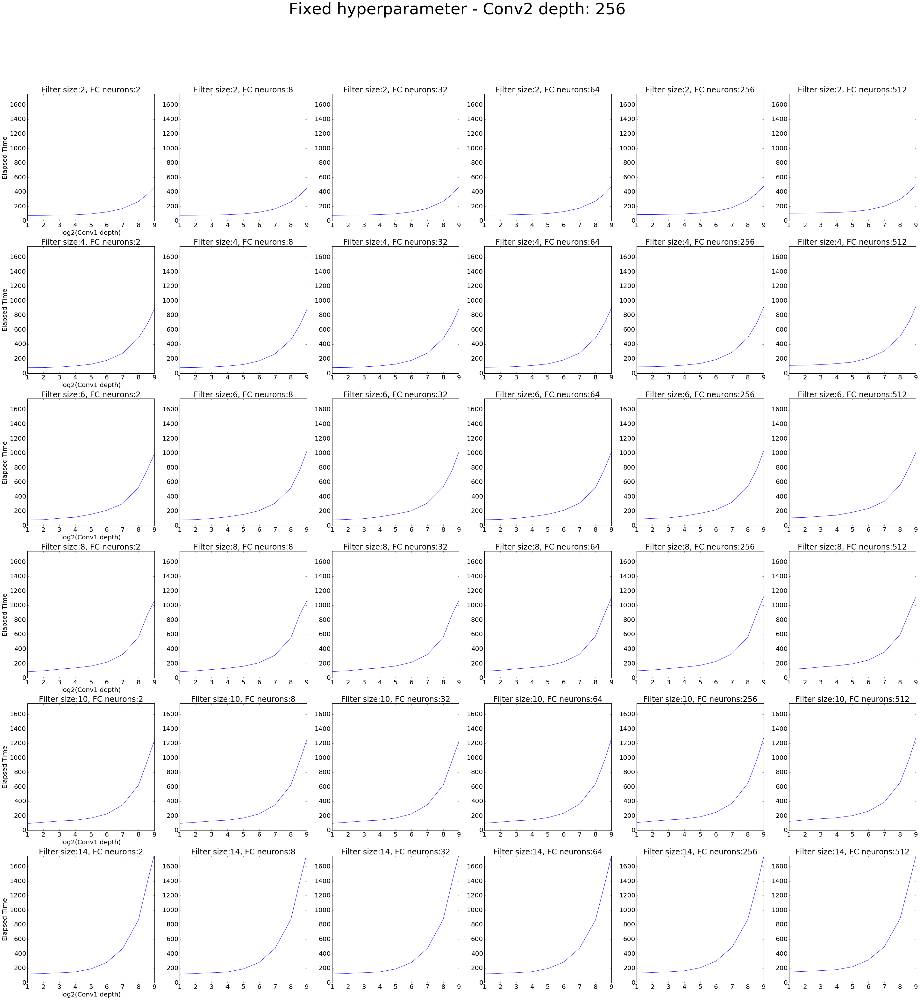

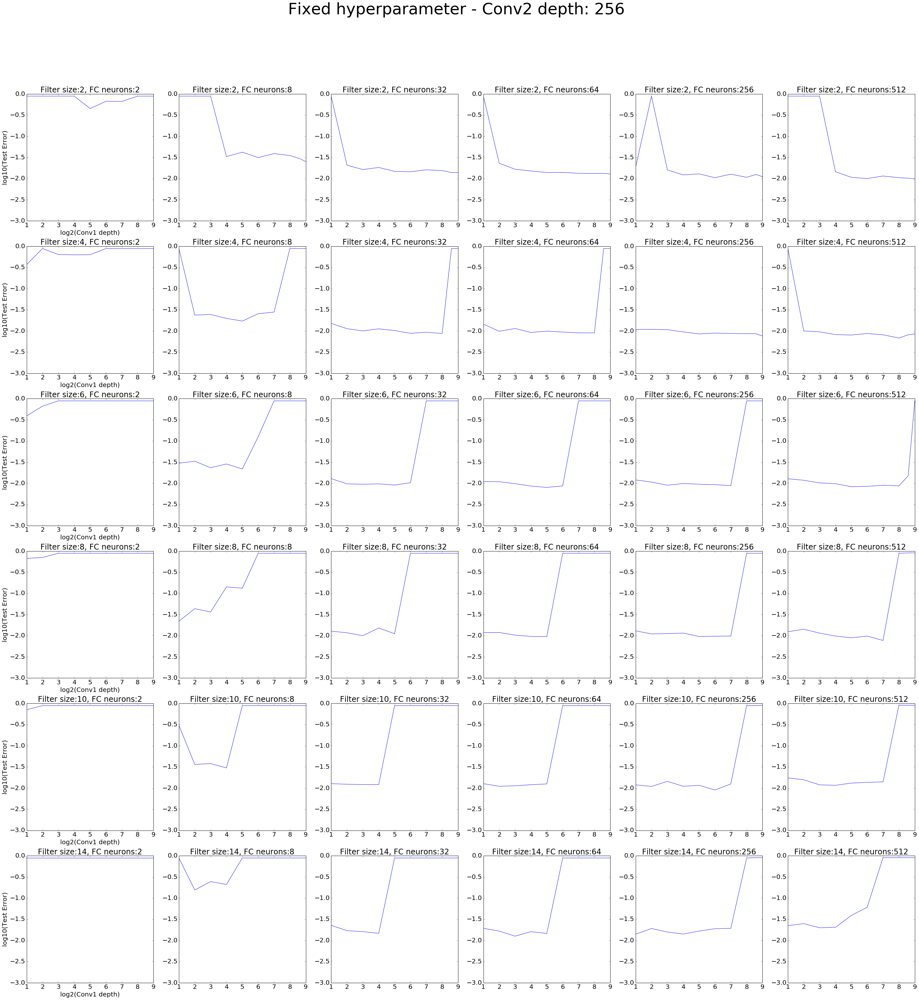

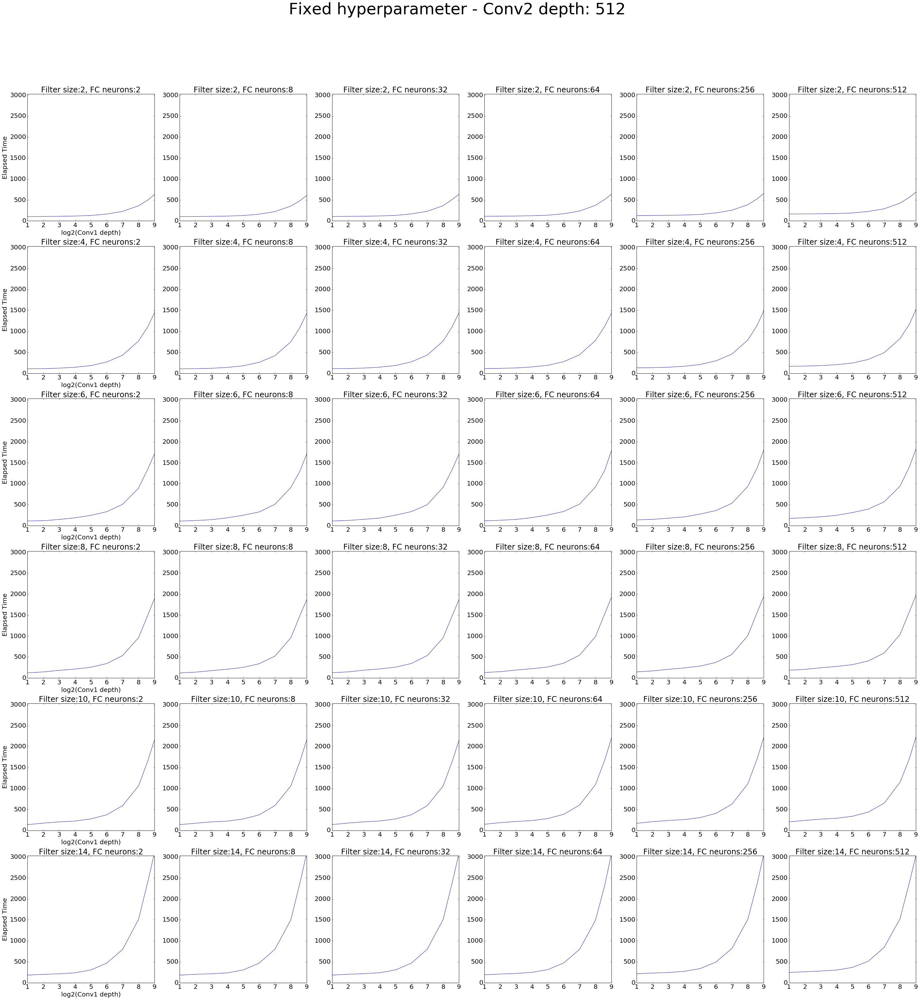

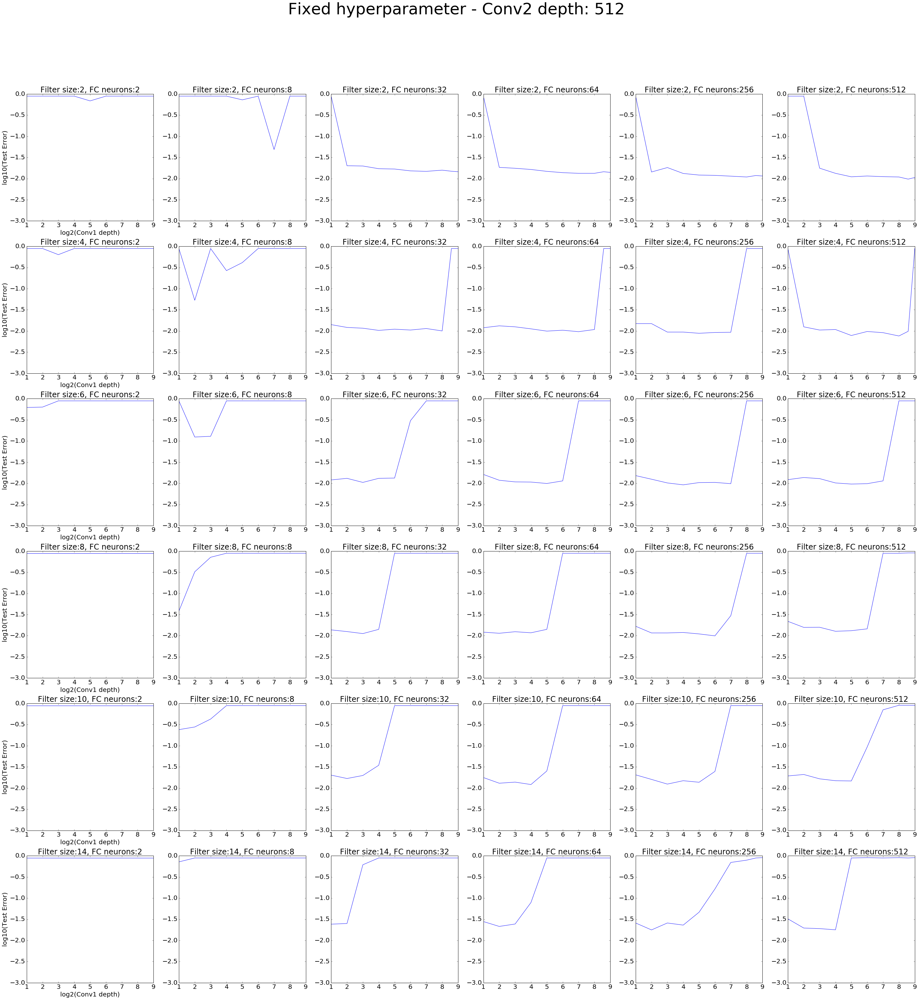

In [33]:
filter_sizes = [1, 2, 4, 6, 8, 10, 12, 14]
conv1_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
conv2_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
fc_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
conv2_list = [2, 8, 32, 64, 256, 512]
fc_list = [2, 8, 32, 64, 256, 512]
filter_sizes = [2, 4, 6, 8, 10, 14]
#conv2_list = [2, 8, 32, 64, 256, 512]
#fc_list = [2, 8, 32, 128, 384, 512]
x_axis = {"name" : "Filter size", "values" : filter_sizes}
y_axis = {"name" : "FC neurons", "values" : fc_list}
outputs = ["Elapsed Time", "Test Error"]
selected_dim = "Conv1 depth"

for conv2 in conv2_list:
    for output in outputs:
        fixed = {"name": "Conv2 depth", "value": conv2}
        draw_n_by_n_plots(total_only_table, fixed, x_axis, y_axis, selected_dim, output, False, True, True)

Conv1_depth_2-Elapsed_Time.png is saved successfully.
Conv1_depth_2-Test_Error.png is saved successfully.
Conv1_depth_8-Elapsed_Time.png is saved successfully.
Conv1_depth_8-Test_Error.png is saved successfully.
Conv1_depth_32-Elapsed_Time.png is saved successfully.
Conv1_depth_32-Test_Error.png is saved successfully.
Conv1_depth_64-Elapsed_Time.png is saved successfully.
Conv1_depth_64-Test_Error.png is saved successfully.
Conv1_depth_256-Elapsed_Time.png is saved successfully.
Conv1_depth_256-Test_Error.png is saved successfully.
Conv1_depth_512-Elapsed_Time.png is saved successfully.
Conv1_depth_512-Test_Error.png is saved successfully.


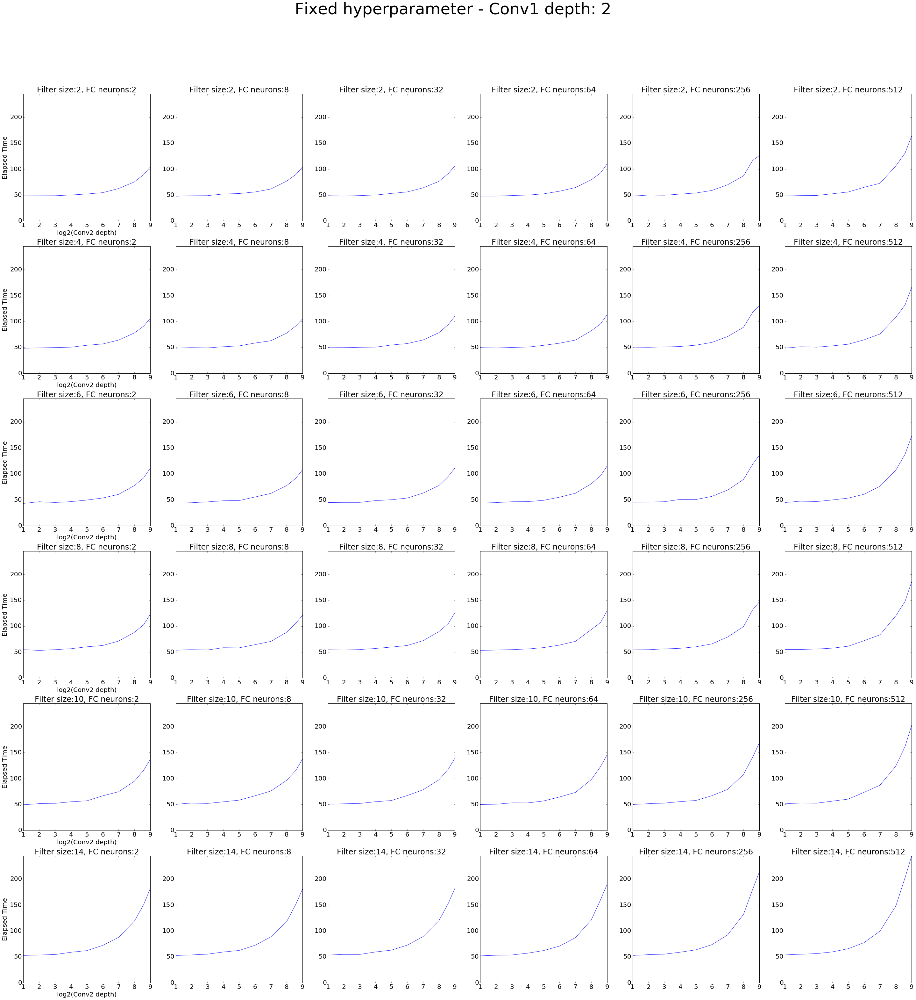

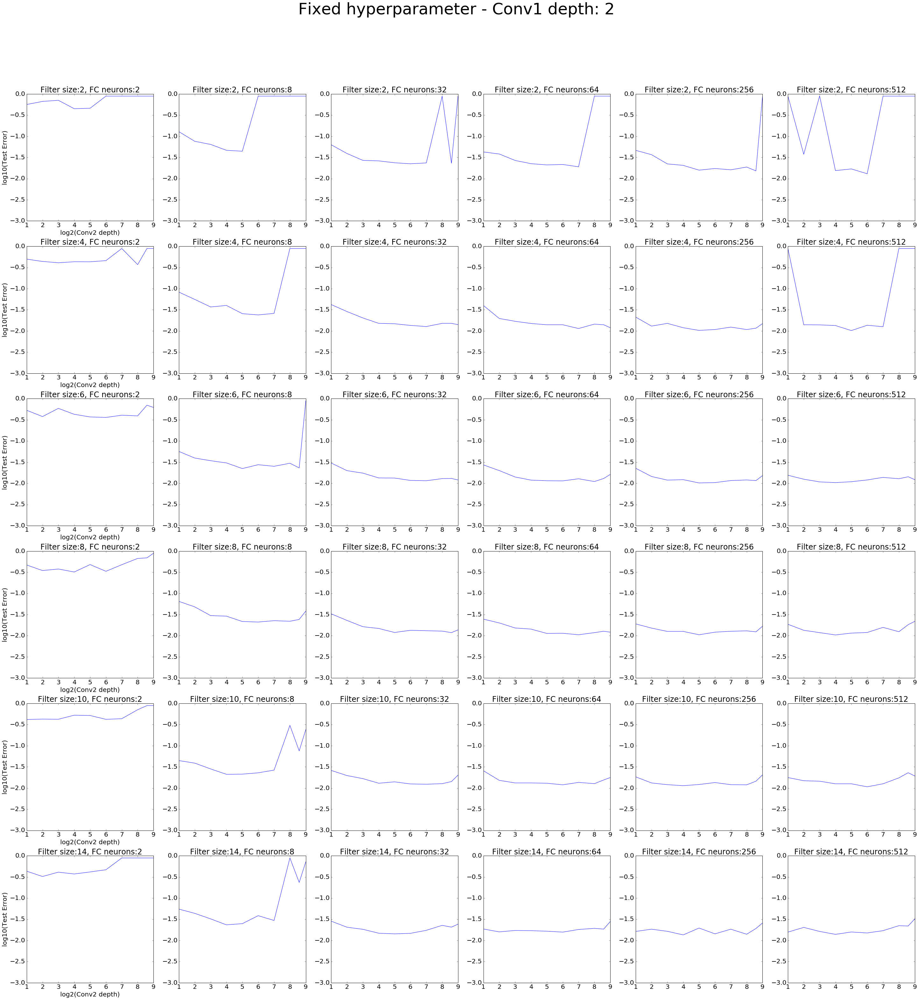

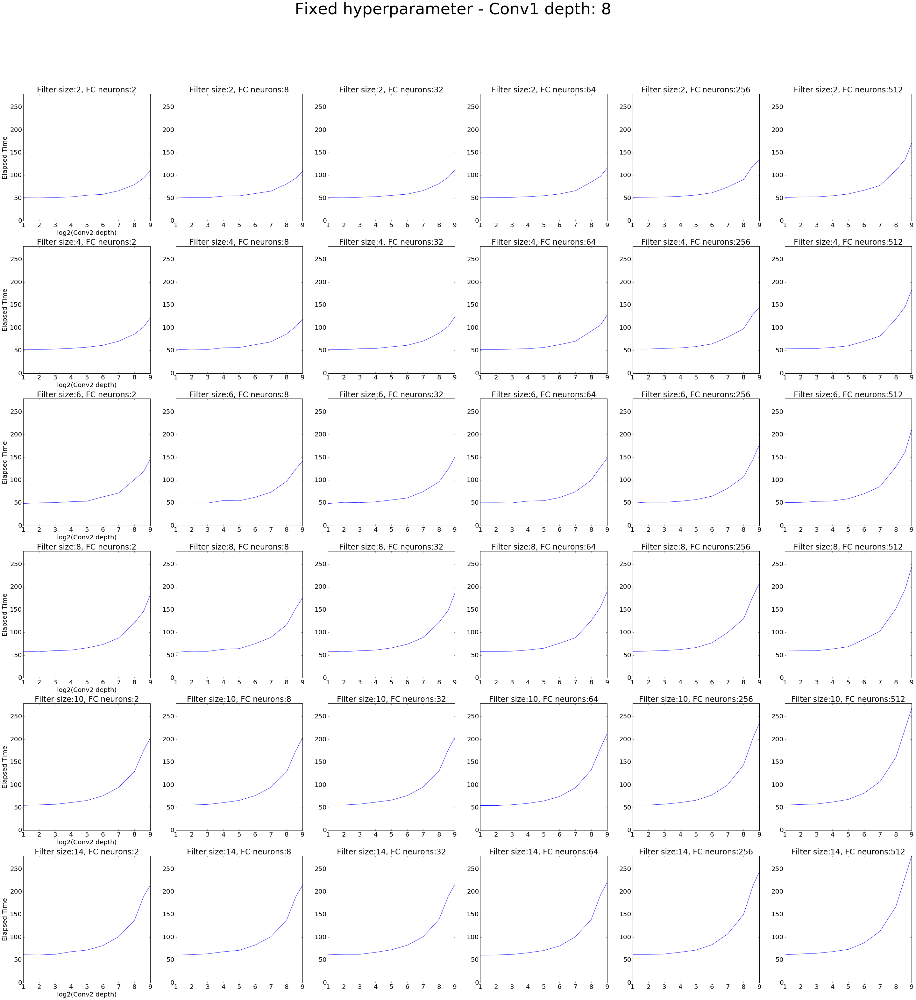

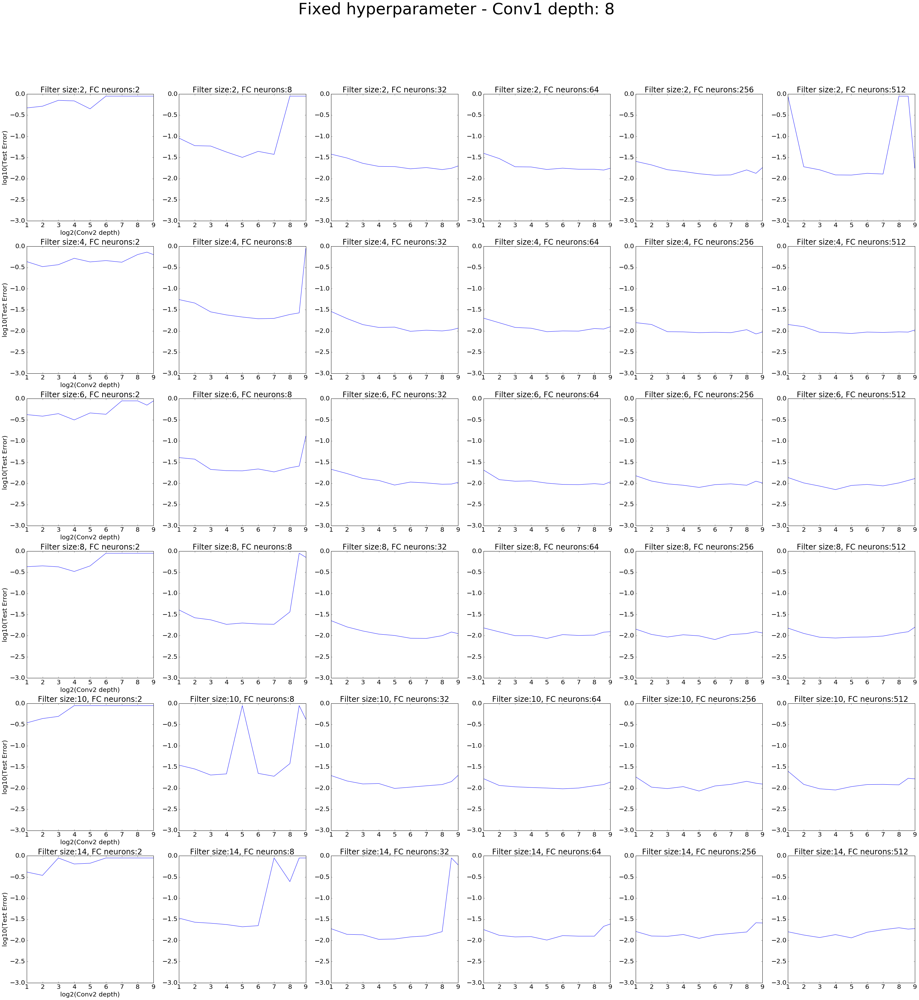

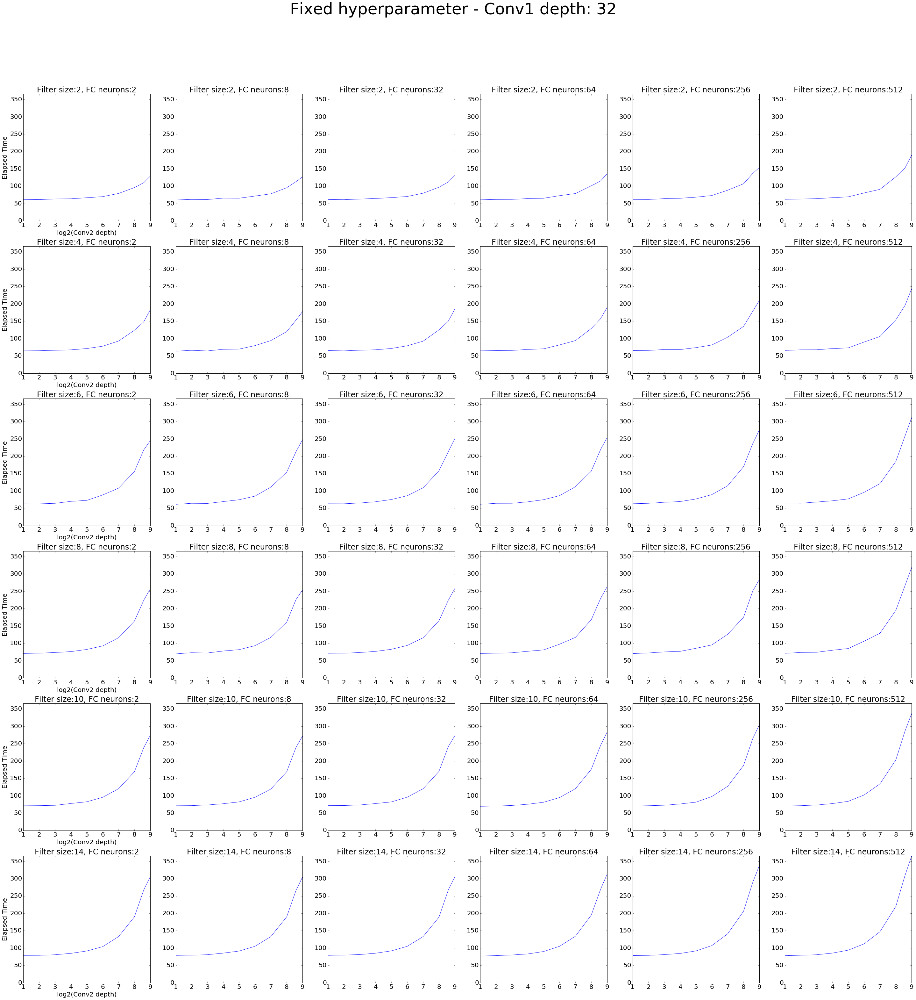

...

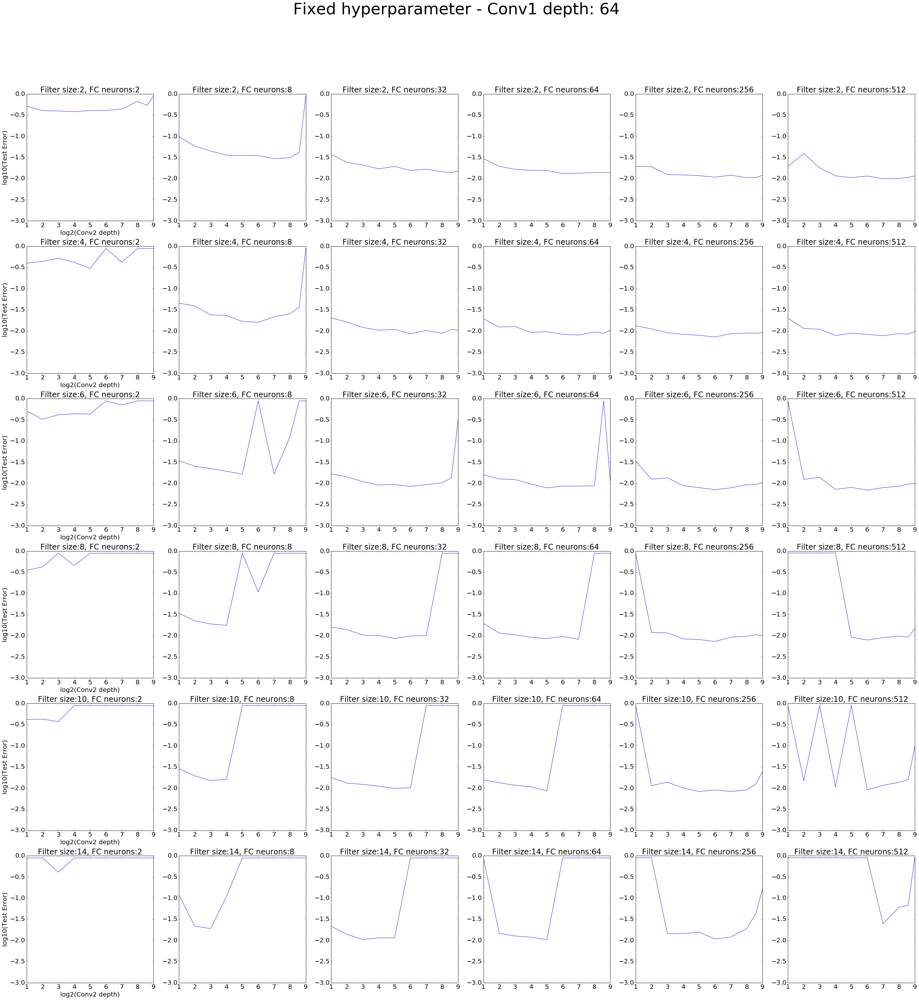

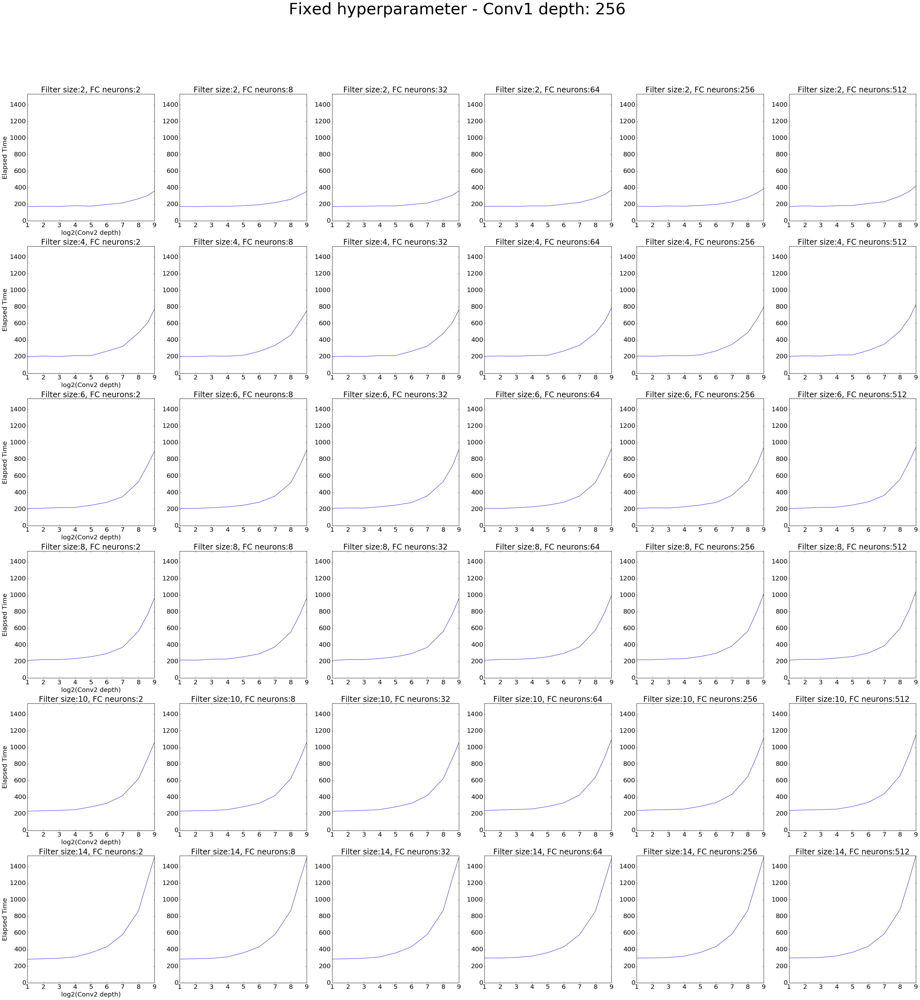

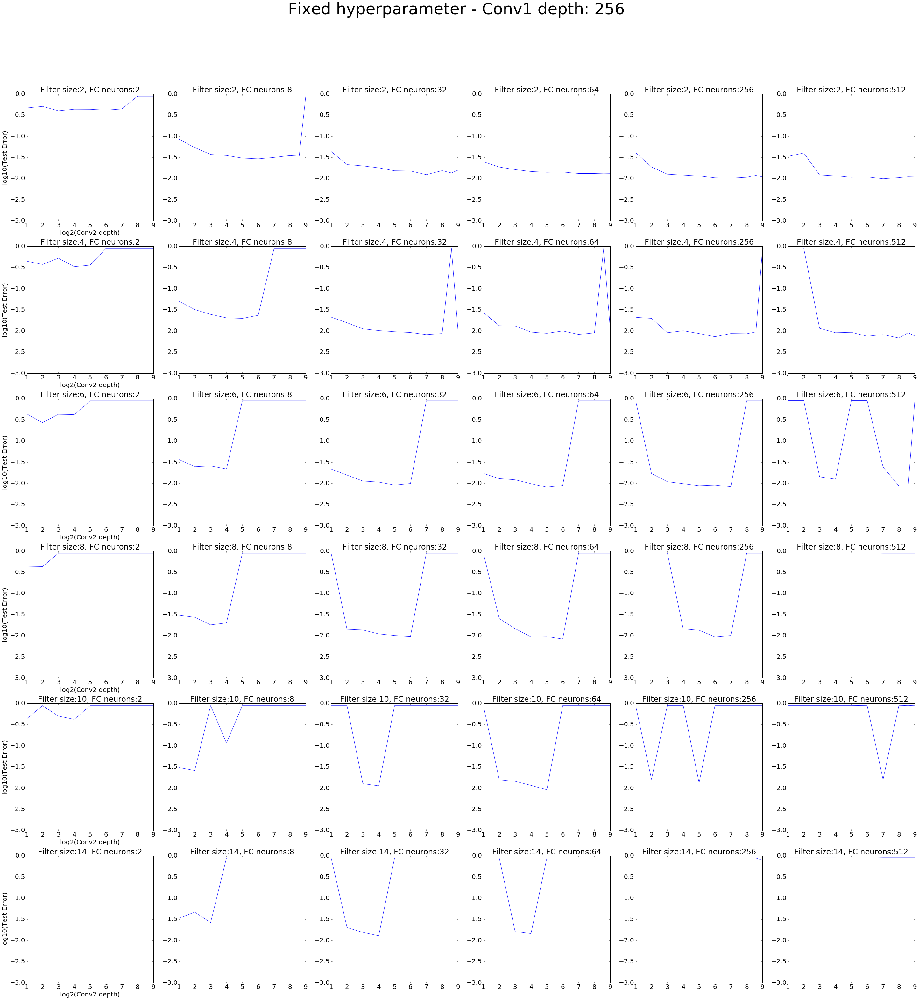

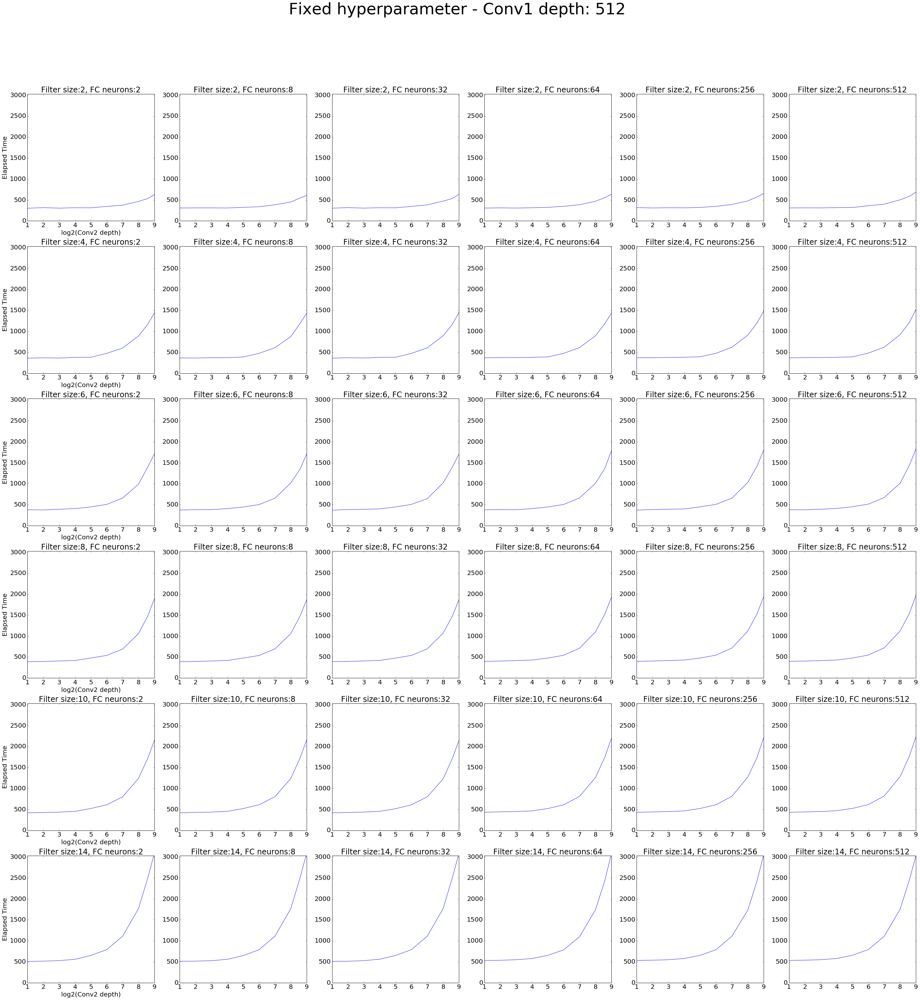

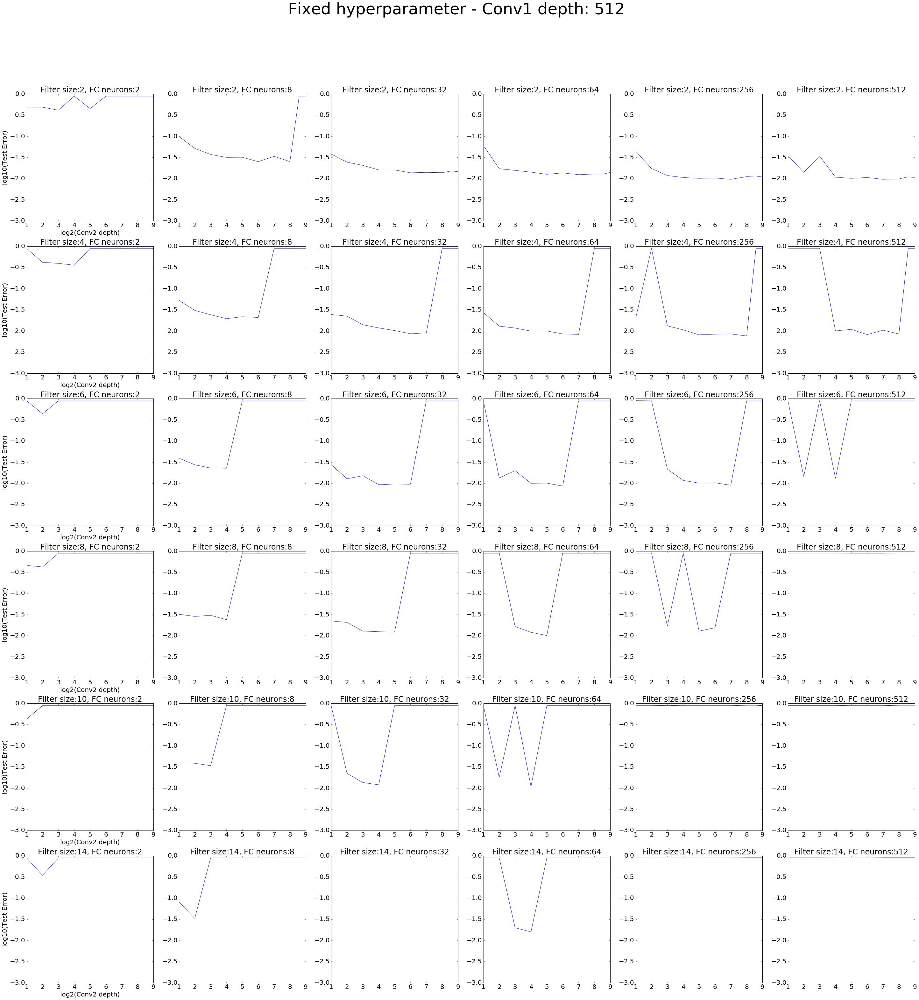

In [34]:
filter_sizes = [1, 2, 4, 6, 8, 10, 12, 14]
conv1_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
conv2_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
fc_list = [2, 4, 8, 16, 32, 64, 128, 256, 384, 512]
conv1_list = [2, 8, 32, 64, 256, 512]
fc_list = [2, 8, 32, 64, 256, 512]
filter_sizes = [2, 4, 6, 8, 10, 14]
#conv2_list = [2, 8, 32, 64, 256, 512]
#fc_list = [2, 8, 32, 128, 384, 512]
x_axis = {"name" : "Filter size", "values" : filter_sizes}
y_axis = {"name" : "FC neurons", "values" : fc_list}
outputs = ["Elapsed Time", "Test Error"]
selected_dim = "Conv2 depth"

for conv1 in conv1_list:
    for output in outputs:
        fixed = {"name": "Conv1 depth", "value": conv1}
        draw_n_by_n_plots(total_only_table, fixed, x_axis, y_axis, selected_dim, output, False, True, True)